# Adult


In [1]:
import warnings
warnings.filterwarnings('ignore')

In [2]:
import pandas as pd

In [3]:
adult = pd.read_csv('adult.csv', names=['age', 'workclass', 'fnlwgt', 'education',
                                     'education-num','marital-status', 'occupation',
                                     'relationship', 'race', 'gender','capital-gain',
                                     'capital-loss', 'hours-per-week', 'native-country',
                                     'income'], sep = ', ', engine='python')
adult.head()

,age,workclass,fnlwgt,education,education-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K


###### change 'income' to numerical variable

In [4]:
adult['income'] = adult['income'].replace({'<=50K': 0, '>50K': 1})
adult.head()

,age,workclass,fnlwgt,education,education-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,0
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,0
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,0
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,0
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,0


###### drop unknown values

In [5]:
adult = adult[(adult!='?').all(axis=1)].reset_index(drop=True)

###### drop 'education' feature

In [6]:
adult.drop('education', axis=1, inplace=True)

###### isolate features

In [7]:
adultX = adult.drop(["income"], axis=1)

###### scale all features that need scaling

In [483]:
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler, MinMaxScaler


ct = make_column_transformer(
    (StandardScaler(),['age', 'fnlwgt','capital-gain', 'capital-loss', 'hours-per-week']),
    (OneHotEncoder(sparse=False, handle_unknown='ignore'), ['workclass','marital-status','occupation','relationship','race','gender','native-country']),
    (MinMaxScaler(), ['education-num']))

In [9]:
ct.fit(adultX)
adultX_trans = ct.transform(adultX)
print(adultX_trans.shape)

(30162, 88)


### KMeans on adult data

In [10]:
from sklearn.cluster import KMeans

In [11]:
kmeans = KMeans(n_clusters=2, random_state = 26)
kmeans.fit(adultX_trans)

# Evaluate the clustering results
print(kmeans.inertia_)

229106.7519121228


In [12]:
import matplotlib.pyplot as plt

In [13]:
analysisData = adultX.copy()

In [14]:
analysisData['cluster'] = kmeans.labels_

In [15]:
import seaborn as sns

In [16]:
adult.income.value_counts(normalize = True)

0    0.751078
1    0.248922
Name: income, dtype: float64

In [17]:
analysisData['cluster'].value_counts(normalize = True)

0    0.502221
1    0.497779
Name: cluster, dtype: float64

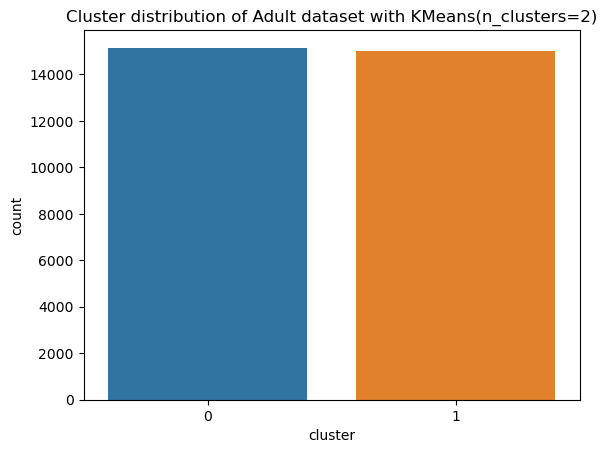

In [18]:
sns.countplot(x = analysisData['cluster'])
plt.title("Cluster distribution of Adult dataset with KMeans(n_clusters=2)")
plt.show()

In [19]:
analysisData.head()

,age,workclass,fnlwgt,education-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,cluster
0,39,State-gov,77516,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,1
1,50,Self-emp-not-inc,83311,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,0
2,38,Private,215646,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,1
3,53,Private,234721,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,0
4,28,Private,338409,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,1


In [20]:
categoricalColumns = ['workclass', 'education-num', 'marital-status', 'occupation', 'relationship', 'race', 'gender', 'native-country']

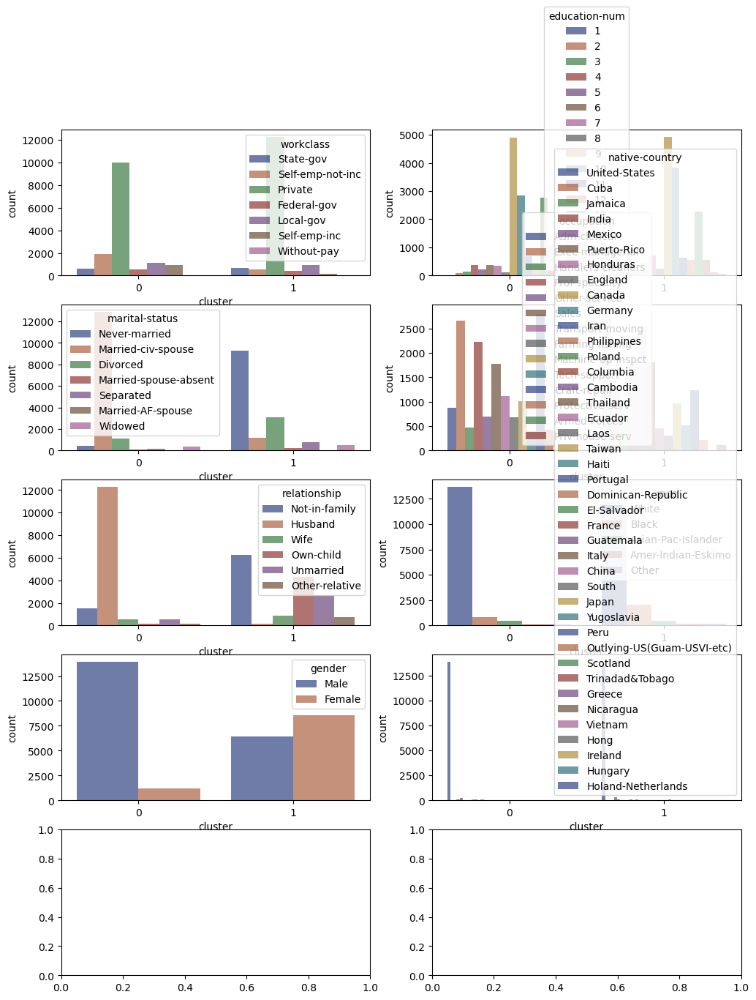

In [21]:
categoricalColumns = ['workclass', 'education-num', 'marital-status', 'occupation', 'relationship', 'race', 'gender', 'native-country']
fig, axes = plt.subplots(5,2,figsize=(12,15))
for idx,cat_col in enumerate(categoricalColumns):
    row,col = idx//2,idx%2
    sns.countplot(data=analysisData, x = 'cluster', hue=cat_col, palette = 'dark', alpha=.6, ax = axes[row,col]) 

In [22]:
# sns.countplot(data=analysisData, x = 'cluster', hue='gender', palette = 'dark', alpha=.6) 

In [23]:
analysisData.groupby('relationship')['cluster'].value_counts(normalize = True)

relationship    cluster
Husband         0          0.986841
                1          0.013159
Not-in-family   1          0.807792
                0          0.192208
Other-relative  1          0.831271
                0          0.168729
Own-child       1          0.967309
                0          0.032691
Unmarried       1          0.828767
                0          0.171233
Wife            1          0.631579
                0          0.368421
Name: cluster, dtype: float64

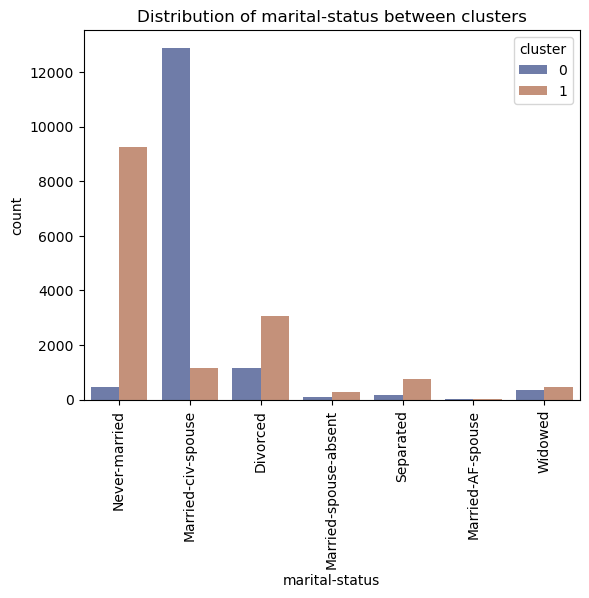

In [24]:
sns.countplot(data=analysisData, x = 'marital-status', hue='cluster', palette = 'dark', alpha=.6)
plt.title("Distribution of marital-status between clusters")
plt.xticks(rotation=90)
plt.show()

In [25]:
adultTransDf = pd.DataFrame(adultX_trans, columns=ct.get_feature_names_out())
adultTransDf
adultTransDf['cluster'] = kmeans.labels_

In [26]:
adultTransDf['income'] = adult['income']

In [27]:
adultTransDf[adultTransDf['income'] == 1]['cluster'].value_counts(normalize=True)

0    0.864145
1    0.135855
Name: cluster, dtype: float64

In [28]:
cx = adultTransDf.drop('cluster', axis = 1).corr().loc[:,['income']]
cx.abs().sort_values(by = 'income', ascending = False)[1:7]#[cx['income'].abs() > 0.3]

,income
onehotencoder__marital-status_Married-civ-spouse,0.445418
onehotencoder__relationship_Husband,0.401236
minmaxscaler__education-num,0.335286
onehotencoder__marital-status_Never-married,0.320053
standardscaler__age,0.241998
standardscaler__hours-per-week,0.229480


In [29]:
cx.loc[cx.abs().sort_values(by = 'income', ascending = False)[1:7].index, ['income']]

,income
onehotencoder__marital-status_Married-civ-spouse,0.445418
onehotencoder__relationship_Husband,0.401236
minmaxscaler__education-num,0.335286
onehotencoder__marital-status_Never-married,-0.320053
standardscaler__age,0.241998
standardscaler__hours-per-week,0.229480


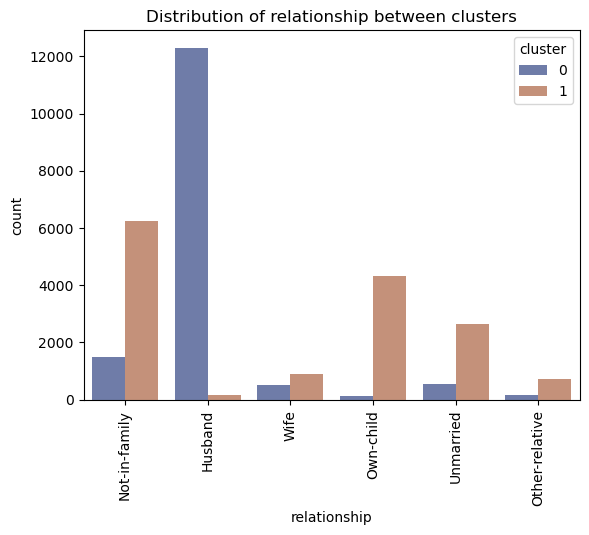

In [30]:
sns.countplot(data=analysisData, x = 'relationship', hue='cluster', palette = 'dark', alpha=.6)
plt.title("Distribution of relationship between clusters")
plt.xticks(rotation=90)
plt.show()

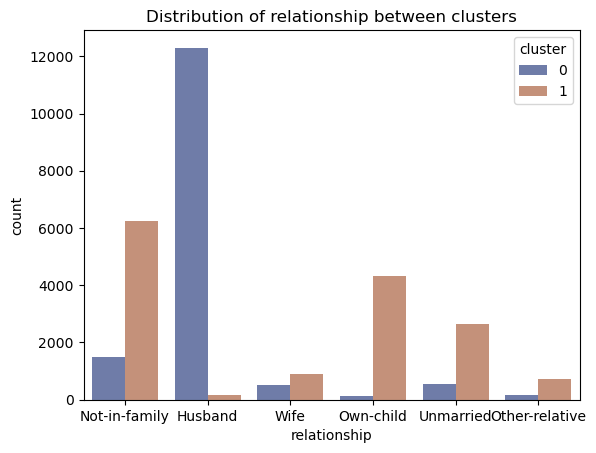

In [31]:
sns.countplot(data=analysisData, x = 'relationship', hue='cluster', palette = 'dark', alpha=.6)
plt.title("Distribution of relationship between clusters")
plt.show()

# Check counts

In [32]:
# analysisData.groupby('education-num')['cluster'].value_counts()

In [33]:
# analysisData.drop(['workclass', 'education-num', 'marital-status', 'occupation', 'relationship', 'race', 'gender','education-num'], axis=1)

In [118]:
adultTransDf[adultTransDf['income'] == 0]['cluster'].value_counts(normalize=True)

1    0.617728
0    0.382272
Name: cluster, dtype: float64

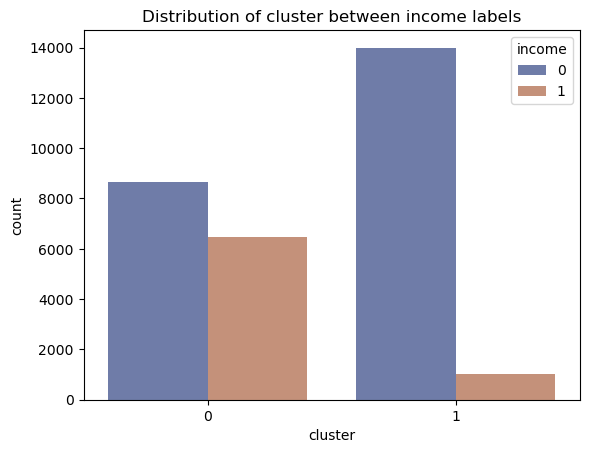

In [34]:
# g = adultTransDf.groupby(['cluster', 'income']).size().groupby(level=0).apply(lambda x: x).reset_index(name='count')
# g #adultTransDf.groupby('cluster')['income'].value_counts()

sns.countplot(data=adultTransDf, x = 'cluster', hue='income', palette = 'dark', alpha=.6)
plt.title("Distribution of cluster between income labels")
plt.show()

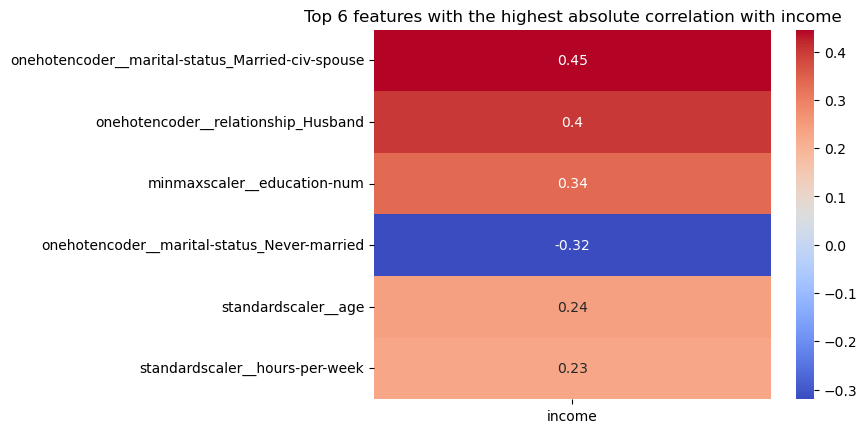

In [35]:
corr = cx.loc[cx.abs().sort_values(by = 'income', ascending = False)[1:7].index, ['income']]#adultTransDf.loc[:, ['onehotencoder__relationship_Husband', 'income']].corr()

# plot the correlation matrix using heatmap
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.title("Top 6 features with the highest absolute correlation with income")
# show the plot
plt.show()

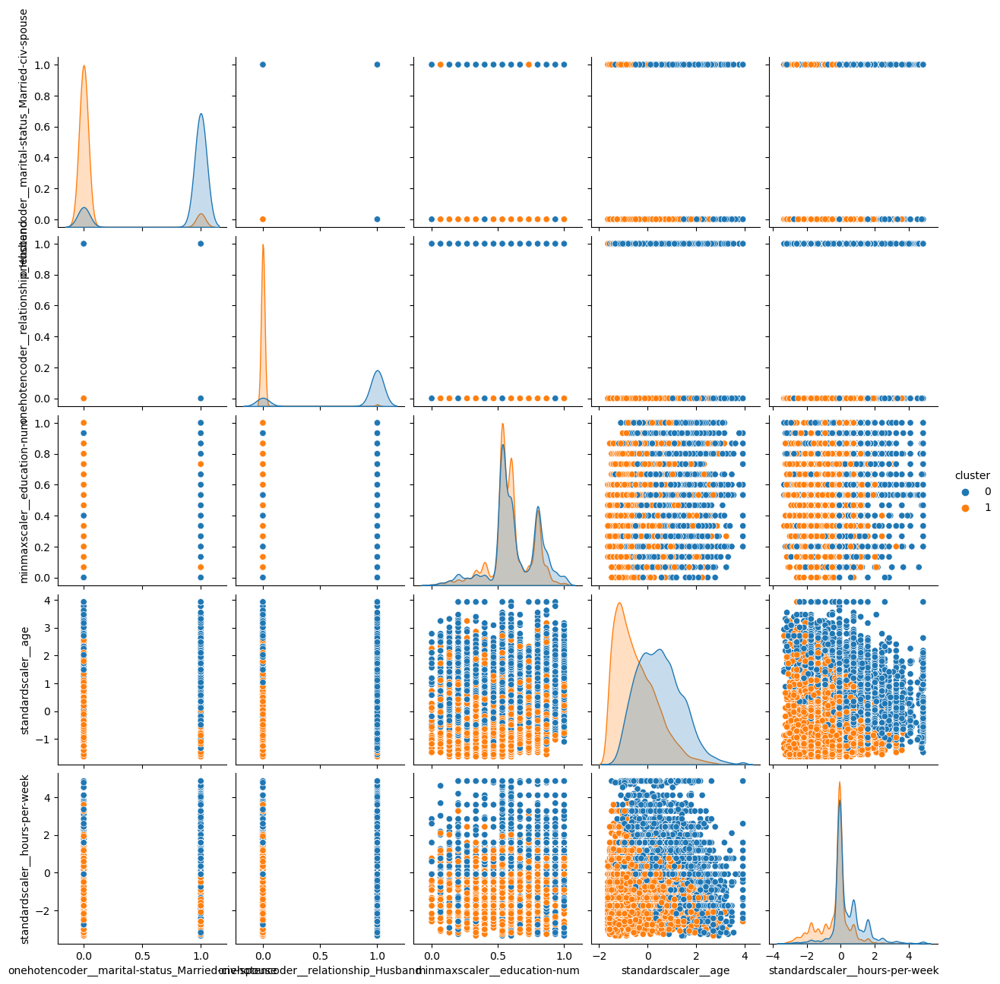

In [34]:
sns.pairplot(adultTransDf.loc[:,['onehotencoder__marital-status_Married-civ-spouse','onehotencoder__relationship_Husband','minmaxscaler__education-num','standardscaler__age','standardscaler__hours-per-week', 'cluster']], hue = 'cluster')

###### all working more than 90hrs/week are in cluster 0

###### majority of those older than 

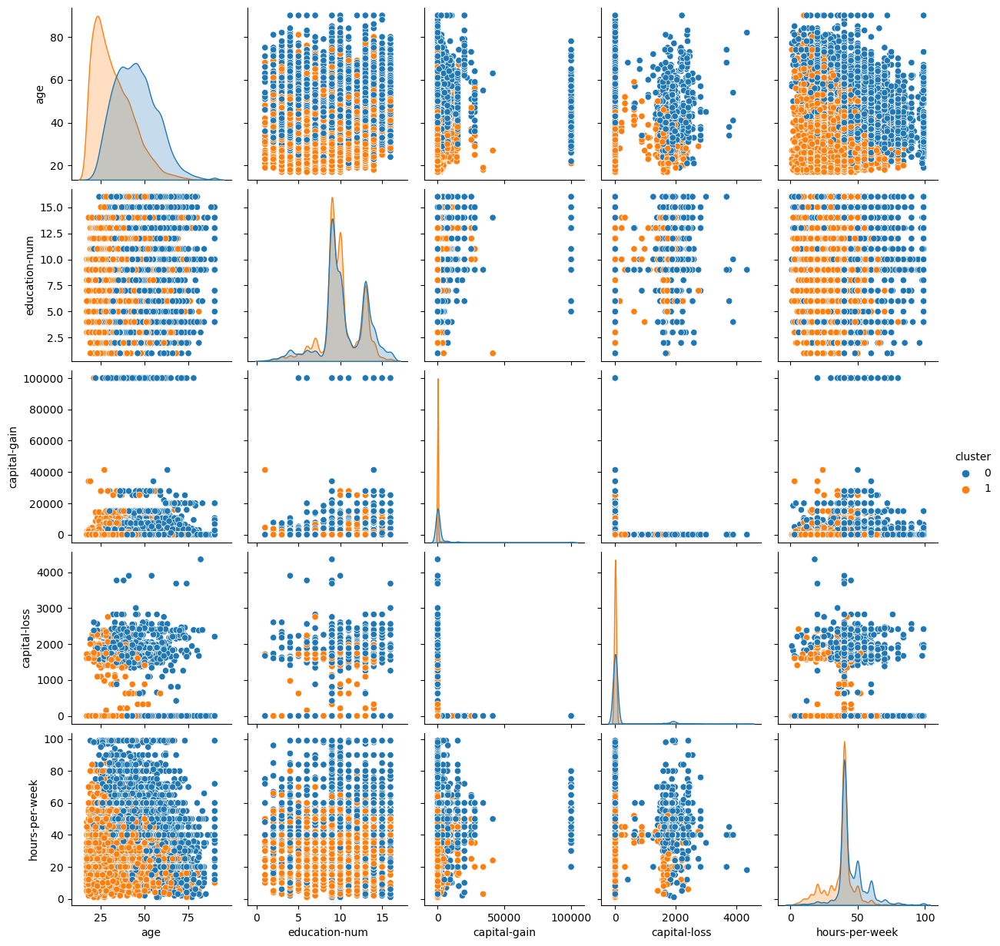

In [35]:
sns.pairplot(analysisData.drop(['workclass', 'fnlwgt', 'marital-status', 'occupation', 'relationship', 'race', 'gender'], axis=1), hue = 'cluster')

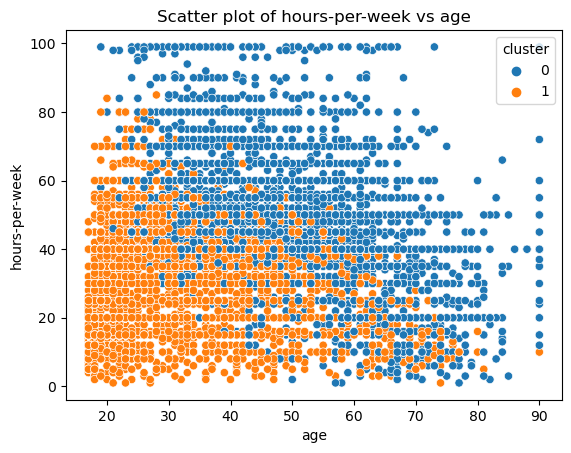

In [36]:
import matplotlib.pyplot as plt


sns.scatterplot(data=analysisData, x='age', y='hours-per-week', hue='cluster')


# set the title and axis labels
plt.title('Scatter plot of hours-per-week vs age')
plt.ylabel('hours-per-week')
plt.xlabel('age')
plt.legend(title='cluster', loc='upper right')
# display the plot
plt.show()

###### cluster 0 members are older than cluster 1

In [37]:
analysisData[analysisData['cluster']==1].describe()

,age,fnlwgt,education-num,capital-gain,capital-loss,hours-per-week,cluster
count,15014.000000,1.501400e+04,15014.000000,15014.000000,15014.000000,15014.000000,15014.0
mean,31.996803,1.975573e+05,9.901758,264.369722,31.133142,36.547955,1.0
std,11.016304,1.109308e+05,2.337108,1977.576406,230.592743,10.681684,0.0
min,17.000000,1.376900e+04,1.000000,0.000000,0.000000,1.000000,1.0
25%,23.000000,1.221350e+05,9.000000,0.000000,0.000000,32.000000,1.0
50%,30.000000,1.844395e+05,10.000000,0.000000,0.000000,40.000000,1.0
75%,39.000000,2.474450e+05,11.000000,0.000000,0.000000,40.000000,1.0
max,90.000000,1.484705e+06,16.000000,99999.000000,2754.000000,85.000000,1.0


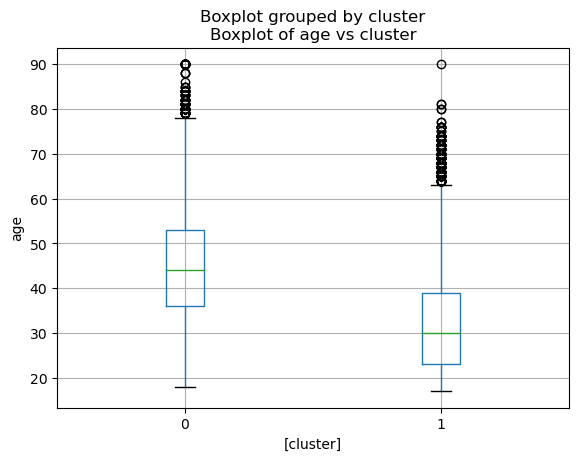

In [38]:
analysisData.loc[:,['age', 'cluster']].boxplot(by = 'cluster')
plt.title("Boxplot of age vs cluster")
plt.ylabel("age")
plt.show()

###### cluster 0 work more hours than 1

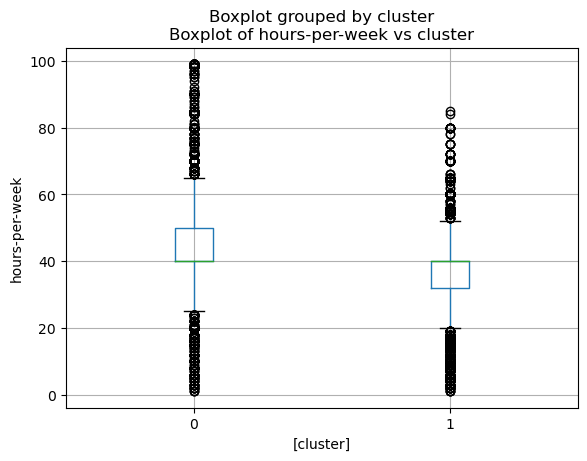

In [39]:
analysisData.loc[:,['hours-per-week', 'cluster']].boxplot(by = 'cluster')
plt.title("Boxplot of hours-per-week vs cluster")
plt.ylabel("hours-per-week")
plt.show()

In [40]:
from sklearn.metrics import classification_report
print(classification_report(adult.income, analysisData.cluster))

              precision    recall  f1-score   support

           0       0.57      0.38      0.46     22654
           1       0.07      0.14      0.09      7508

    accuracy                           0.32     30162
   macro avg       0.32      0.26      0.27     30162
weighted avg       0.45      0.32      0.37     30162



In [41]:
reverseCluster = analysisData.copy()

In [42]:
reverseCluster['cluster'] = reverseCluster['cluster'].replace({1: 0, 0: 1})

In [43]:
print(classification_report(adult.income, reverseCluster.cluster))

              precision    recall  f1-score   support

           0       0.93      0.62      0.74     22654
           1       0.43      0.86      0.57      7508

    accuracy                           0.68     30162
   macro avg       0.68      0.74      0.66     30162
weighted avg       0.81      0.68      0.70     30162



In [44]:
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer


def elbowPlotKMeans(frame):
    kmeans_elbow = KMeans()
    visualizer = KElbowVisualizer(kmeans_elbow, k=(2, 15), locate_elbow=True)
    visualizer.fit(frame)
    visualizer.show()

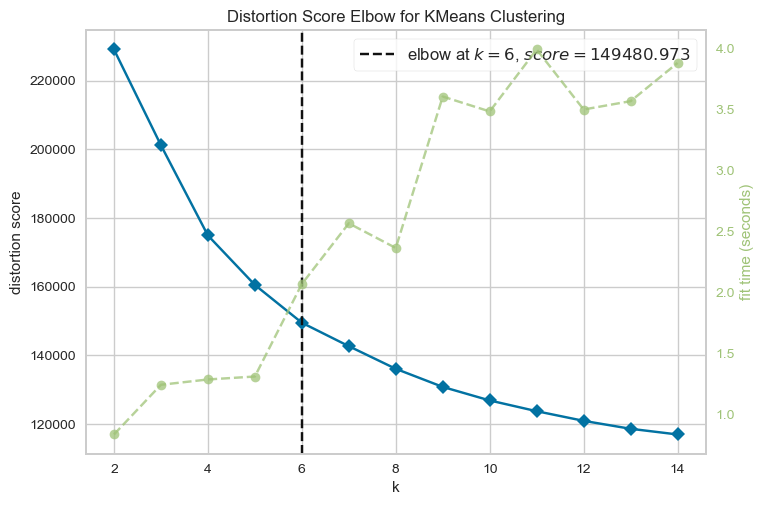

In [47]:
elbowPlotKMeans(adultX_trans)

In [45]:
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm
import numpy as np
import matplotlib.pyplot as plt


def silhouettePlotKMeans(data_set):
    range_n_clusters = [2, 3, 4, 5, 6, 7, 8, 9]
    for n_clusters in range_n_clusters:
        fig, ax1 = plt.subplots(1)
        fig.set_size_inches(18, 7)

        ax1.set_xlim([-0.1, 1])

        ax1.set_ylim([0, len(data_set) + (n_clusters + 1) * 10])

        clusterer = KMeans(n_clusters=n_clusters, random_state=10)
        cluster_labels = clusterer.fit_predict(data_set)

        silhouette_avg = silhouette_score(data_set, cluster_labels)
        print(
            "For n_clusters =",
            n_clusters,
            "The average silhouette_score is :",
            silhouette_avg,
        )

        sample_silhouette_values = silhouette_samples(data_set, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / n_clusters)
            ax1.fill_betweenx(
                np.arange(y_lower, y_upper),
                0,
                ith_cluster_silhouette_values,
                facecolor=color,
                edgecolor=color,
                alpha=0.7,
            )

            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            y_lower = y_upper + 10

        ax1.set_title("The silhouette plot for {} clusters.".format(n_clusters))
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")
        ax1.set_yticks([])
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        plt.figure(figsize=(8, 8))
        plt.suptitle(
            "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
            % n_clusters,
            fontsize=14,
            fontweight="bold",
        )

    plt.show()

For n_clusters = 2 The average silhouette_score is : 0.13284443230409834
For n_clusters = 3 The average silhouette_score is : 0.15352018837492334
For n_clusters = 4 The average silhouette_score is : 0.15228326060090722
For n_clusters = 5 The average silhouette_score is : 0.1620573309312631
For n_clusters = 6 The average silhouette_score is : 0.15872885688134414
For n_clusters = 7 The average silhouette_score is : 0.15137266954782738
For n_clusters = 8 The average silhouette_score is : 0.14299853885643035
For n_clusters = 9 The average silhouette_score is : 0.11770249565936047


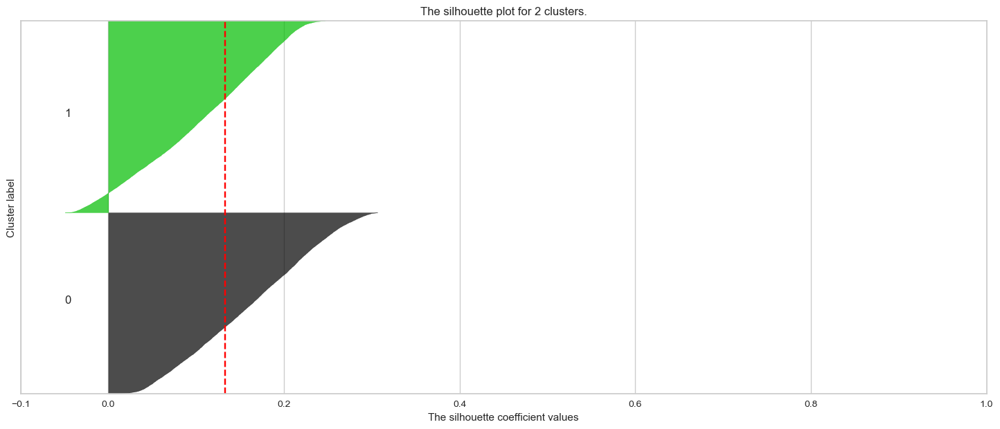

<Figure size 800x800 with 0 Axes>

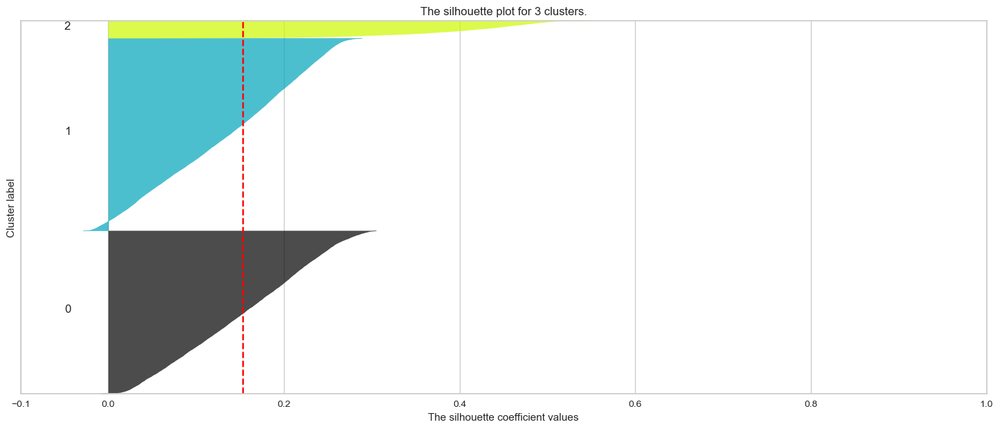

<Figure size 800x800 with 0 Axes>

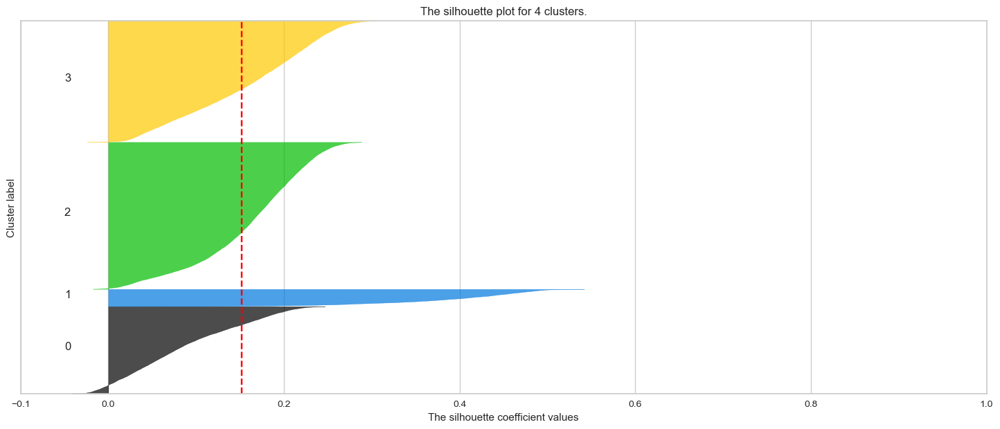

<Figure size 800x800 with 0 Axes>

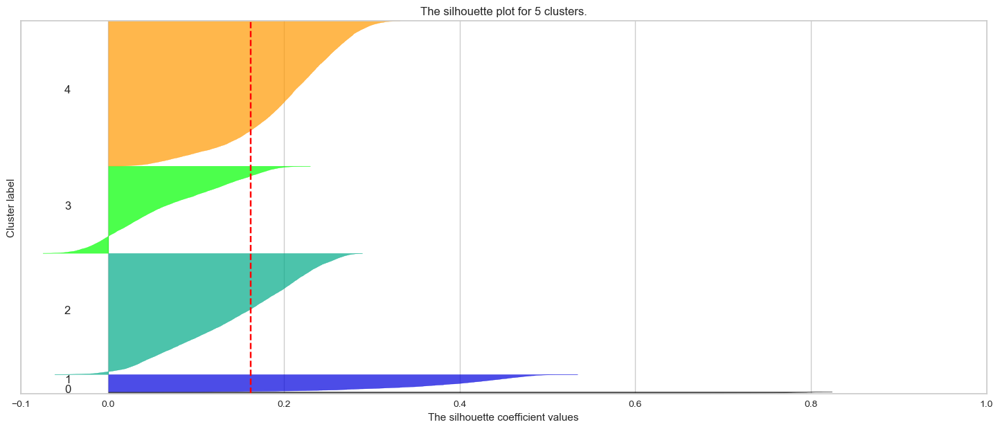

<Figure size 800x800 with 0 Axes>

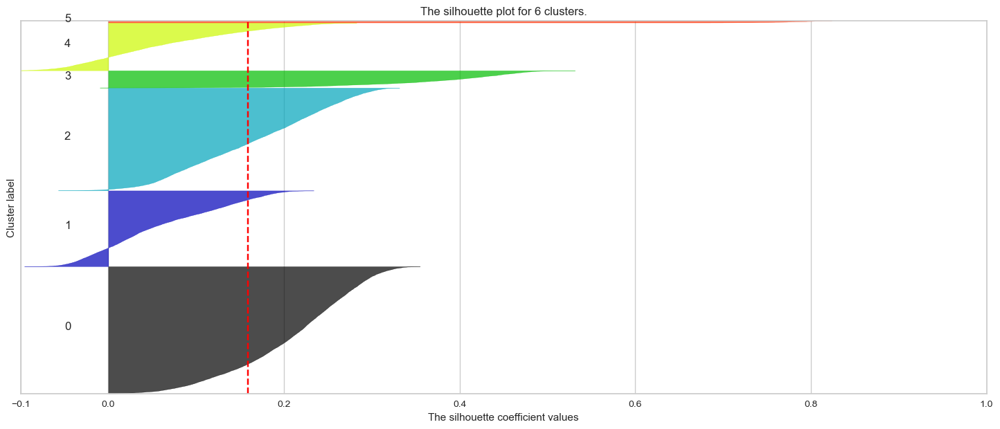

<Figure size 800x800 with 0 Axes>

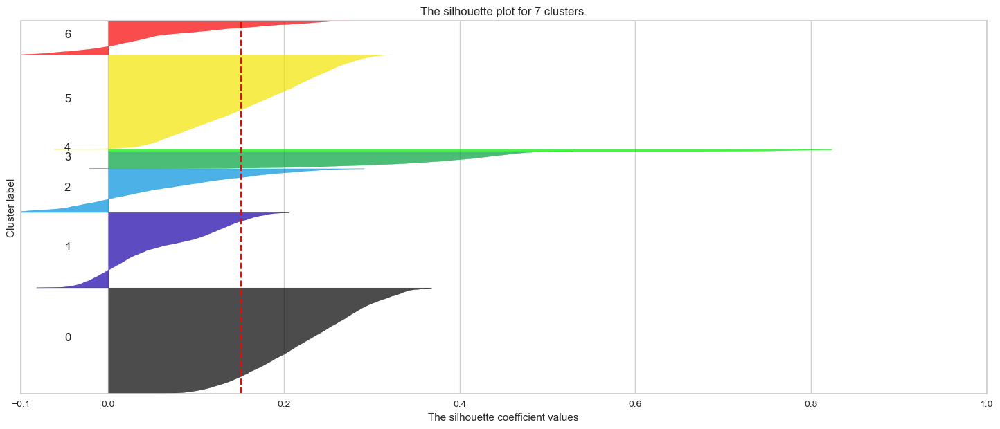

<Figure size 800x800 with 0 Axes>

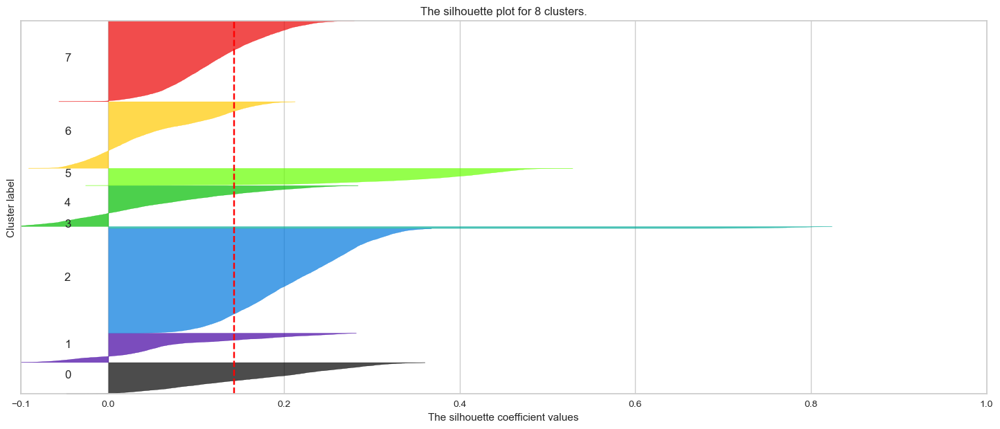

<Figure size 800x800 with 0 Axes>

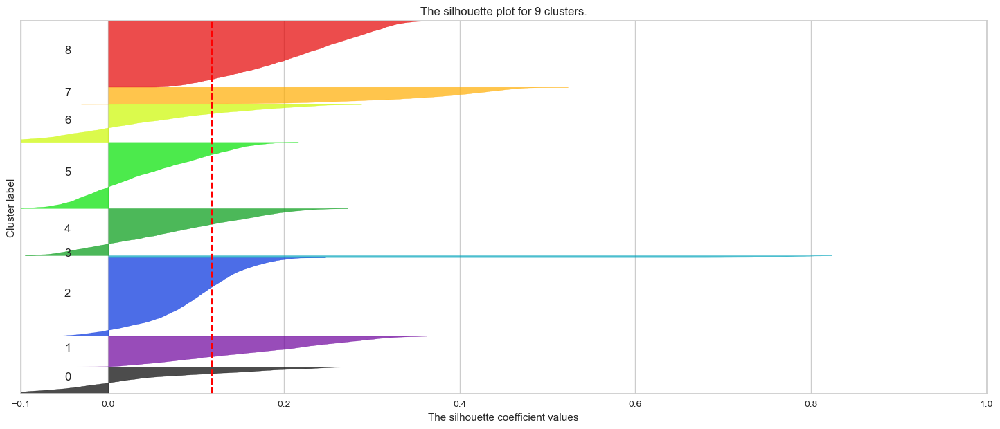

<Figure size 800x800 with 0 Axes>

In [49]:
silhouettePlotKMeans(adultX_trans)

In [46]:
kmeans6 = KMeans(n_clusters=6, random_state = 26)
kmeans6.fit(adultX_trans)

KMeans(n_clusters=6, random_state=26)

In [47]:
anal6 = adultX.copy()

In [48]:
anal6['cluster'] = kmeans6.labels_

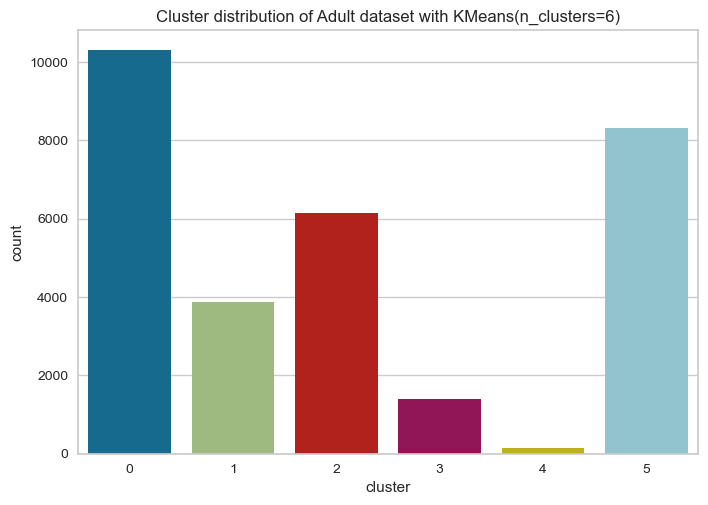

In [49]:
sns.countplot(x = anal6['cluster'])
plt.title("Cluster distribution of Adult dataset with KMeans(n_clusters=6)")
plt.show()

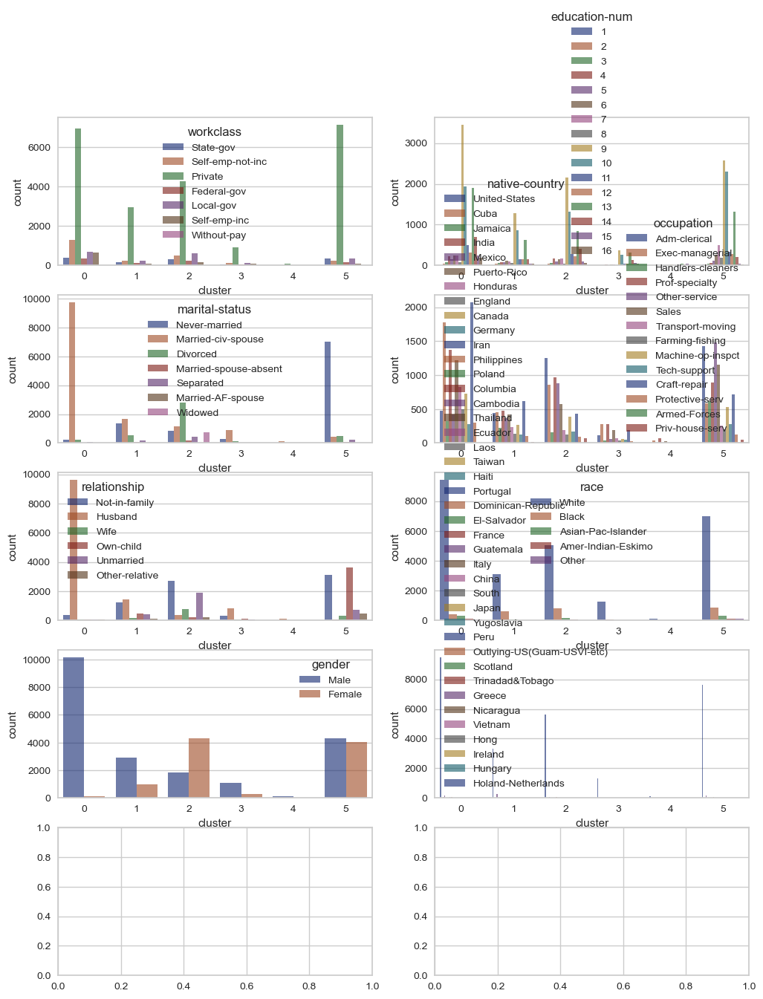

In [50]:
categoricalColumns = ['workclass']+['education-num', 'marital-status', 'occupation', 'relationship', 'race', 'gender', 'native-country']
fig, axes = plt.subplots(5,2,figsize=(12,15))
for idx,cat_col in enumerate(categoricalColumns):
    row,col = idx//2,idx%2
    sns.countplot(data=anal6, x = 'cluster', hue=cat_col, palette = 'dark', alpha=.6, ax = axes[row,col]) 

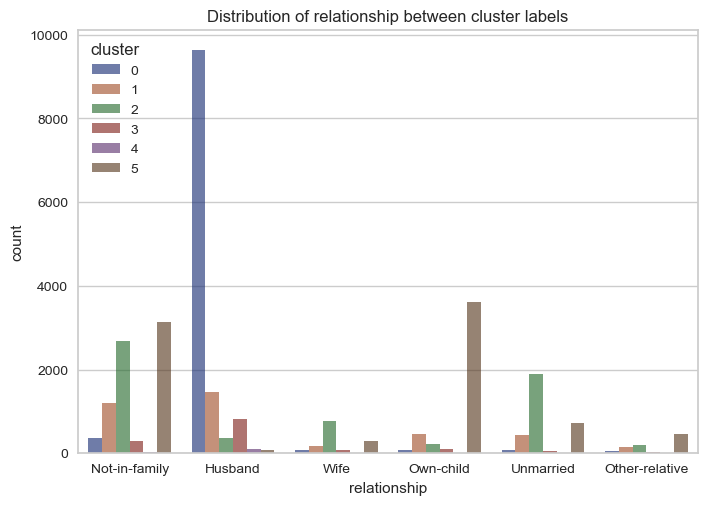

In [51]:
sns.countplot(data=anal6, x = 'relationship', hue='cluster', palette = 'dark', alpha=.6)
plt.title("Distribution of relationship between cluster labels")
plt.show()

In [52]:
anal6.cluster.value_counts()

0    10296
5     8323
2     6138
1     3867
3     1390
4      148
Name: cluster, dtype: int64

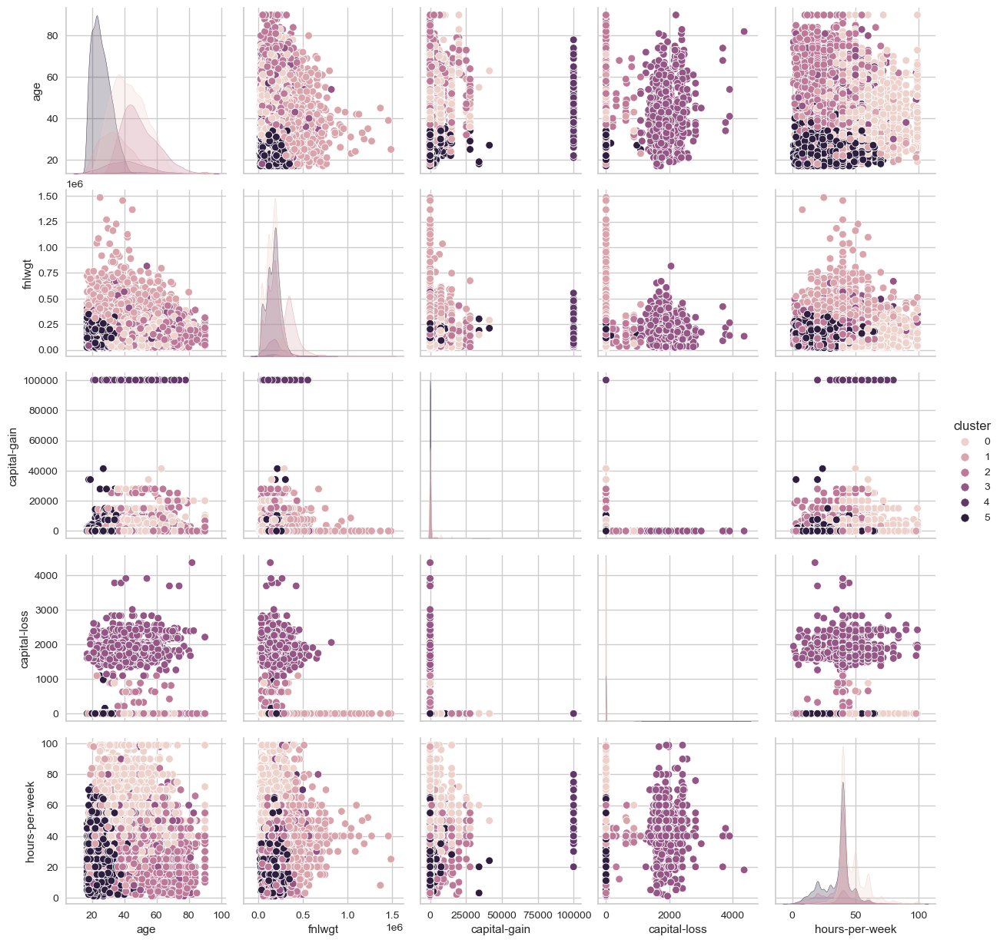

In [53]:
sns.pairplot(anal6.drop(['workclass', 'education-num', 'marital-status', 'occupation', 'relationship', 'race', 'gender'], axis=1), hue = 'cluster')

In [54]:
anal6[anal6['capital-loss']>1500].head()

,age,workclass,fnlwgt,education-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,cluster
22,43,Private,117037,7,Married-civ-spouse,Transport-moving,Husband,White,Male,0,2042,40,United-States,3
48,47,Private,51835,15,Married-civ-spouse,Prof-specialty,Wife,White,Female,0,1902,60,Honduras,3
88,48,Self-emp-not-inc,191277,16,Married-civ-spouse,Prof-specialty,Husband,White,Male,0,1902,60,United-States,3
103,56,Self-emp-not-inc,335605,9,Married-civ-spouse,Other-service,Husband,White,Male,0,1887,50,Canada,3
117,20,Private,111697,10,Never-married,Adm-clerical,Own-child,White,Female,0,1719,28,United-States,3


###### cluster 3 has more capital losses

<AxesSubplot:xlabel='cluster', ylabel='capital-loss'>

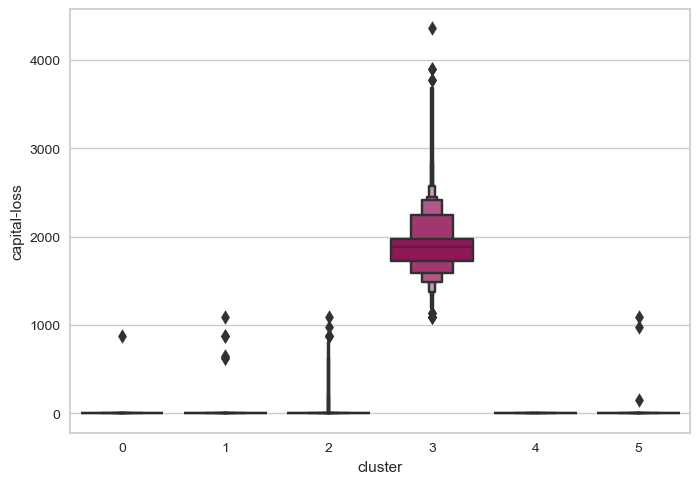

In [55]:
sns.boxenplot(data=anal6, x= 'cluster', y= 'capital-loss')


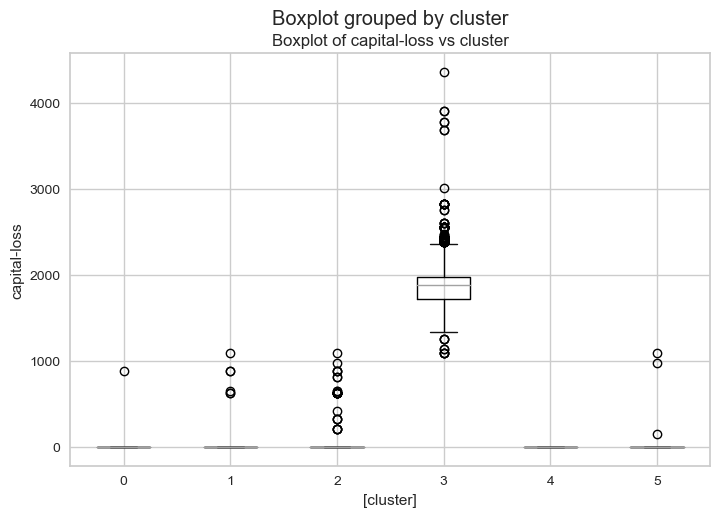

In [56]:
anal6.loc[:,['capital-loss', 'cluster']].boxplot(by = 'cluster')
plt.title("Boxplot of capital-loss vs cluster")
plt.ylabel("capital-loss")
plt.show()

<AxesSubplot:title={'center':'age'}, xlabel='[cluster]'>

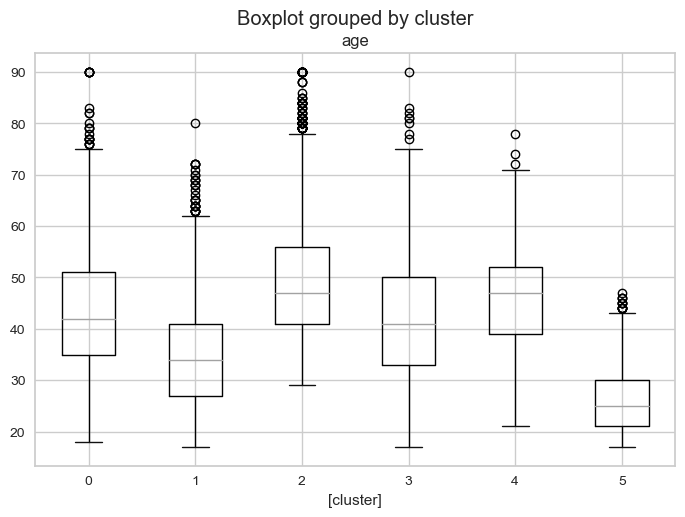

In [57]:
anal6.loc[:,['age', 'cluster']].boxplot(by = 'cluster')

<AxesSubplot:title={'center':'hours-per-week'}, xlabel='[cluster]'>

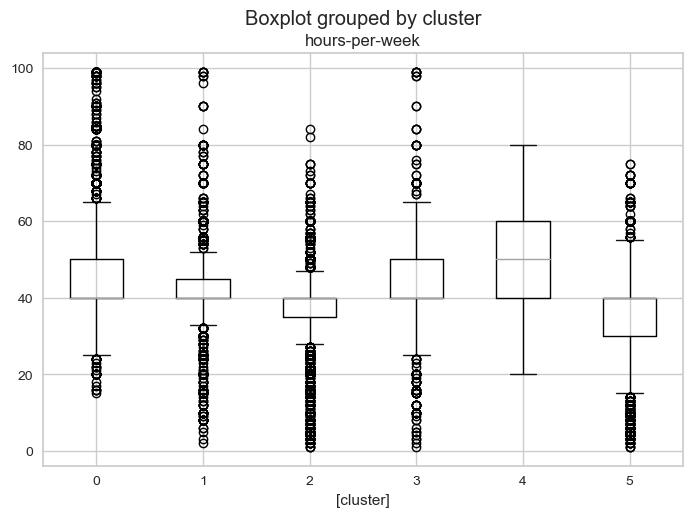

In [58]:
anal6.loc[:,['hours-per-week', 'cluster']].boxplot(by = 'cluster')

In [59]:
from sklearn.mixture import GaussianMixture

In [60]:
def elbowPlotGMM(frame):
     # Initialize lists to store component counts and corresponding BIC scores
    components = []
    bic_scores = []

    # Fit GMM for 1 to max_components components and compute BIC scores
    for n_components in range(2, 15):
        gmm = GaussianMixture(n_components=n_components, random_state = 42)
        gmm.fit(frame)
        components.append(n_components)
        bic_scores.append(gmm.bic(frame))

    # Plot elbow plot
    plt.plot(components, bic_scores, marker='o')
    plt.xlabel('Number of components')
    plt.ylabel('Bayesian Information Criterion')
    plt.title('Elbow Plot for Gaussian Mixture Model')
    plt.show()

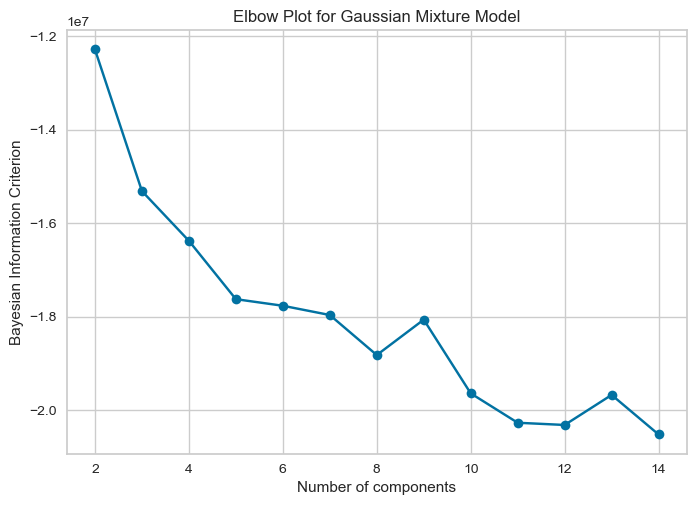

In [67]:
elbowPlotGMM(adultX_trans)

In [61]:
def silhouettePlotGMM(data_set):
    range_n_clusters = [2, 3, 4, 5, 6, 7, 8, 9]
    for n_clusters in range_n_clusters:
        fig, ax1 = plt.subplots(1)
        fig.set_size_inches(18, 7)


        ax1.set_xlim([-1, 1])

        ax1.set_ylim([0, len(data_set) + (n_clusters + 1) * 10])


        clusterer = GaussianMixture(n_components=n_clusters, random_state=42)
        clusterer.fit(data_set)
        cluster_labels = clusterer.predict(data_set)


        silhouette_avg = silhouette_score(data_set, cluster_labels)
        print(
            "For n_clusters =",
            n_clusters,
            "The average silhouette_score is :",
            silhouette_avg,
        )

        sample_silhouette_values = silhouette_samples(data_set, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / n_clusters)
            ax1.fill_betweenx(
                np.arange(y_lower, y_upper),
                0,
                ith_cluster_silhouette_values,
                facecolor=color,
                edgecolor=color,
                alpha=0.7,
            )

            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            y_lower = y_upper + 10 

        ax1.set_title("The silhouette plot for {} clusters.".format(n_clusters))
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")
        ax1.set_yticks([])  
        ax1.set_xticks([-1,-0.8,-0.6,-0.4,-0.2, 0, 0.2, 0.4, 0.6, 0.8, 1])

        plt.figure(figsize=(8, 8))
        plt.suptitle(
            "Silhouette analysis for GaussianMixture clustering on sample data with n_clusters = %d"
            % n_clusters,
            fontsize=14,
            fontweight="bold",
        )

    plt.show()

## overall, the silhouette scores are low, indicating that most of the samples in the clusters generated by the gmm are close to the decision boundary or are in wrong clusters. 

###### elbow plot says 8 clusters but silhouette score n_clusters = 8 is the lowest amont the selected range.

###### all except cluster 6 has some "wrongly" clustered datapoints.

###### cluster 6 which has the highest silhouette score, has a whole cluster less than 0 and not reaching the average

For n_clusters = 2 The average silhouette_score is : 0.06683133334725404
For n_clusters = 3 The average silhouette_score is : 0.08704610977837338
For n_clusters = 4 The average silhouette_score is : 0.07282964407566807
For n_clusters = 5 The average silhouette_score is : 0.022023812040438257
For n_clusters = 6 The average silhouette_score is : 0.11176169288913315
For n_clusters = 7 The average silhouette_score is : 0.11654450693139574
For n_clusters = 8 The average silhouette_score is : 0.010024351576434207
For n_clusters = 9 The average silhouette_score is : 0.07190788025419362


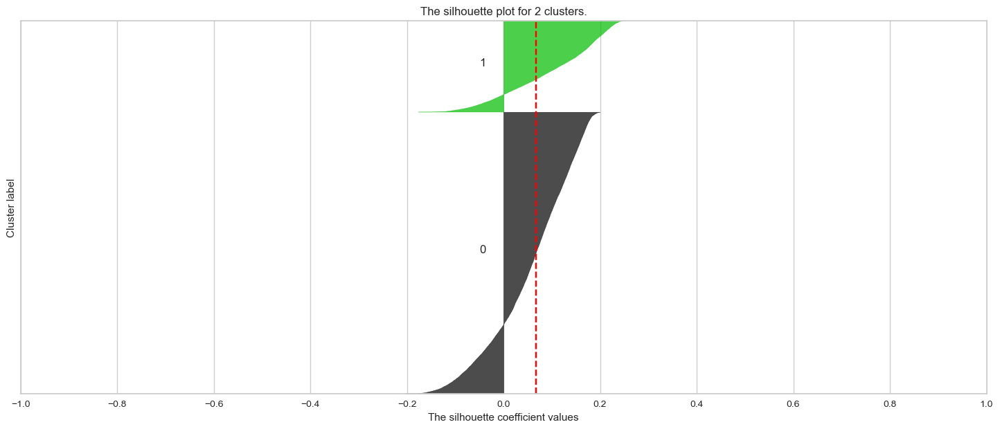

<Figure size 800x800 with 0 Axes>

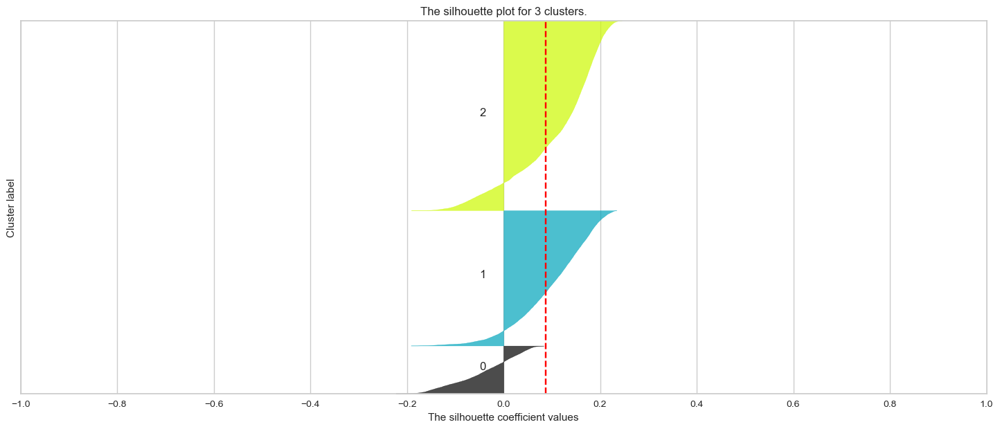

<Figure size 800x800 with 0 Axes>

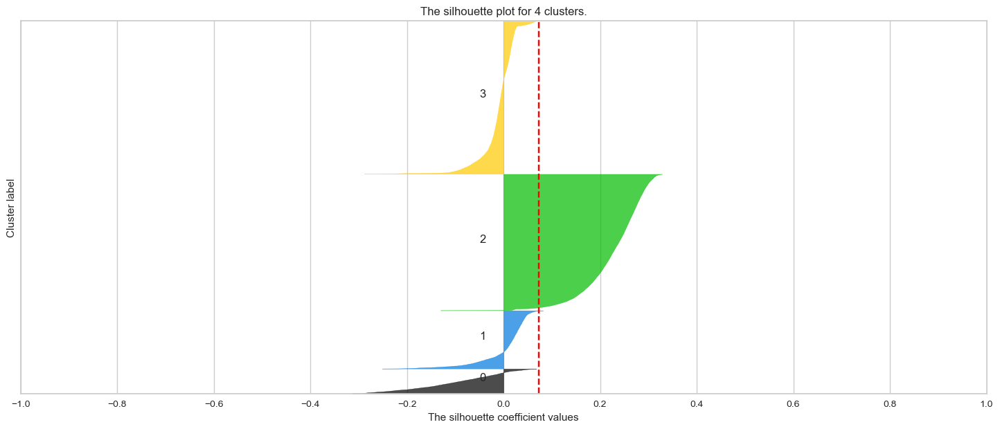

<Figure size 800x800 with 0 Axes>

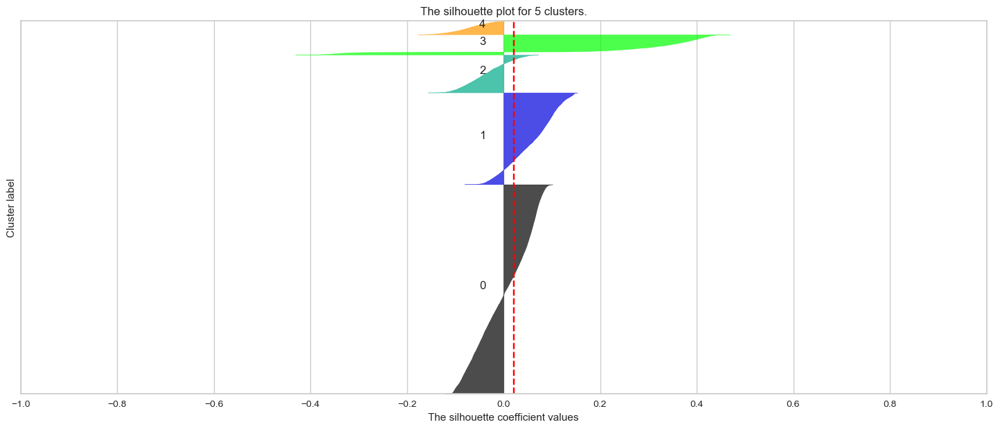

<Figure size 800x800 with 0 Axes>

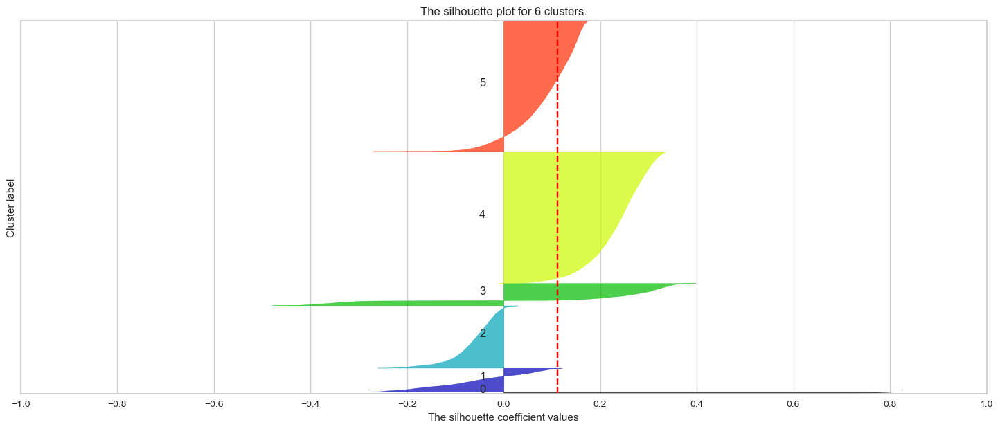

<Figure size 800x800 with 0 Axes>

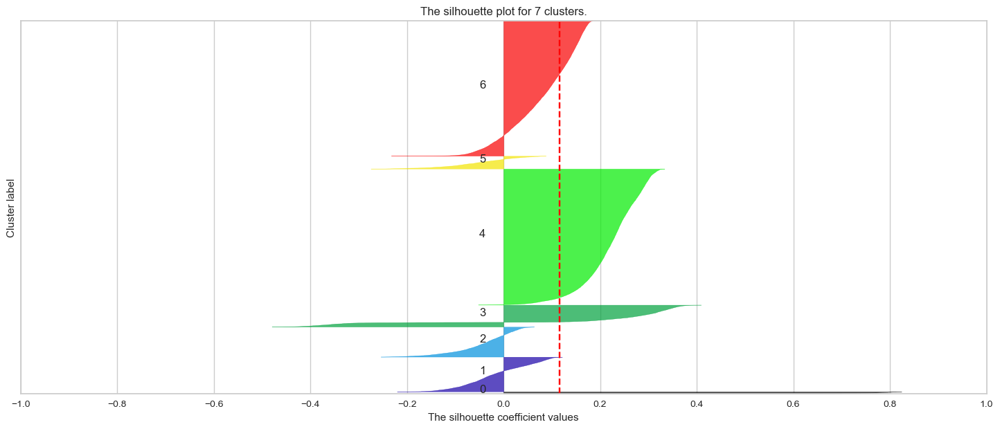

<Figure size 800x800 with 0 Axes>

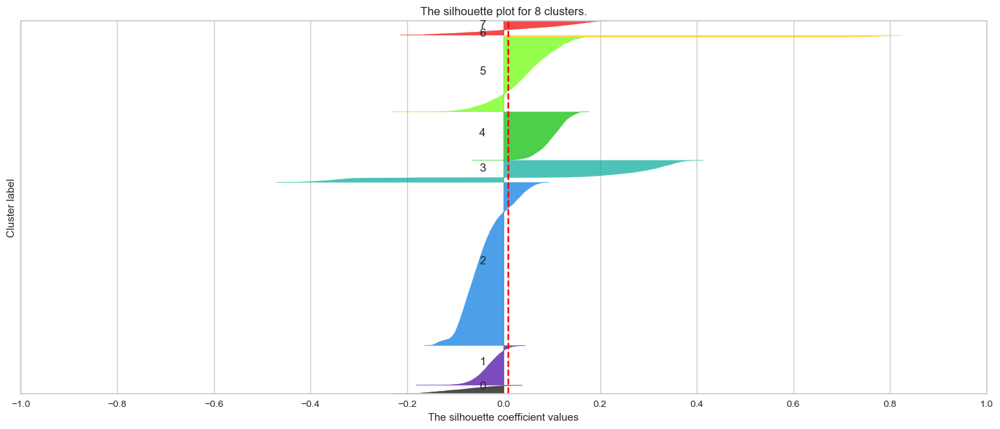

<Figure size 800x800 with 0 Axes>

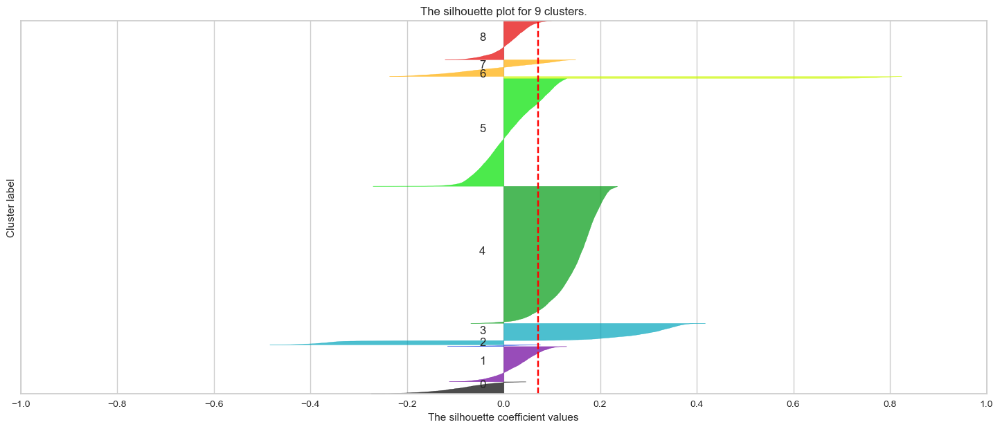

<Figure size 800x800 with 0 Axes>

In [69]:
silhouettePlotGMM(adultX_trans)

In [62]:
gmm = GaussianMixture(n_components=2, random_state=42)

gmm.fit(adultX_trans)

labels = gmm.predict(adultX_trans)

In [63]:
gmmAnal2 = adultX.copy()

gmmAnal2['cluster'] = labels

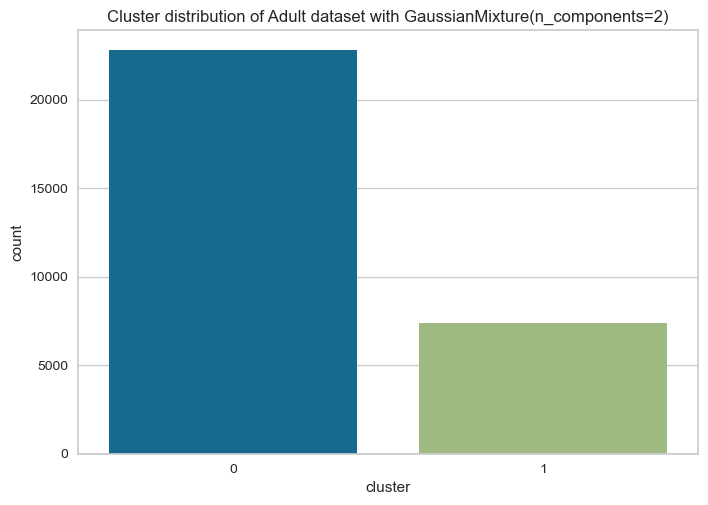

In [64]:
sns.countplot(x = gmmAnal2['cluster'])
plt.title("Cluster distribution of Adult dataset with GaussianMixture(n_components=2)")
plt.show()

In [65]:
adult.income.value_counts(normalize=True)

0    0.751078
1    0.248922
Name: income, dtype: float64

In [66]:
gmmAnal2.cluster.value_counts(normalize=True)

0    0.75562
1    0.24438
Name: cluster, dtype: float64

###### husbands, married-civ-spouse more in cluster 0

###### own-child more in cluster 1

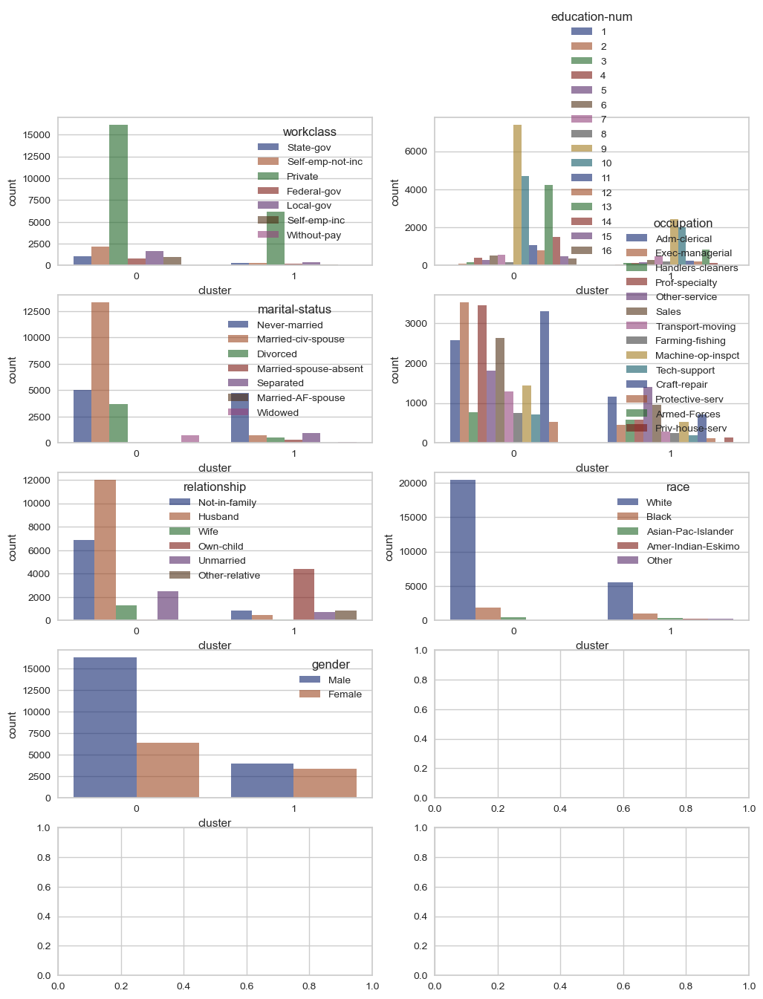

In [67]:
categoricalColumns = ['workclass']+['education-num', 'marital-status', 'occupation', 'relationship', 'race', 'gender']#+[ 'native-country']
fig, axes = plt.subplots(5,2,figsize=(12,15))
for idx,cat_col in enumerate(categoricalColumns):
    row,col = idx//2,idx%2
    sns.countplot(data=gmmAnal2, x = 'cluster', hue=cat_col, palette = 'dark', alpha=.6, ax = axes[row,col])

###### own child make up 0.14 of the dataset but they make up 0.59 of cluster 1

In [68]:
gmmAnal2[gmmAnal2['cluster'] == 1]['relationship'].value_counts(normalize=True)

Own-child         0.594763
Not-in-family     0.118166
Other-relative    0.116945
Unmarried         0.096595
Husband           0.059151
Wife              0.014381
Name: relationship, dtype: float64

In [69]:
gmmAnal2[gmmAnal2['relationship'] == 'Own-child'].groupby('relationship')['cluster'].value_counts()

relationship  cluster
Own-child     1          4384
              0            82
Name: cluster, dtype: int64

In [70]:
gmmAnal2.relationship.value_counts(normalize = True)

Husband           0.413202
Not-in-family     0.256150
Own-child         0.148067
Unmarried         0.106492
Wife              0.046615
Other-relative    0.029474
Name: relationship, dtype: float64

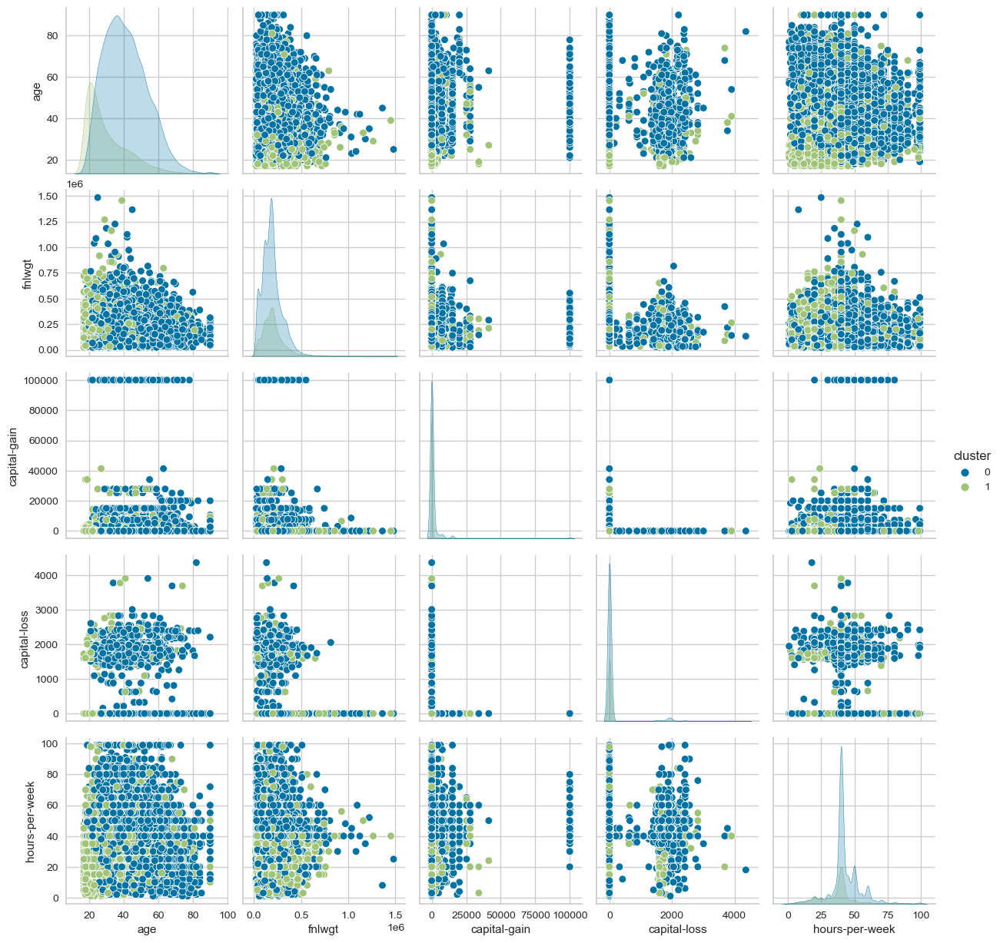

In [71]:
sns.pairplot(gmmAnal2.drop(['workclass', 'education-num', 'marital-status', 'occupation', 'relationship', 'race', 'gender'], axis=1), hue = 'cluster')

<AxesSubplot:title={'center':'age'}, xlabel='[cluster]'>

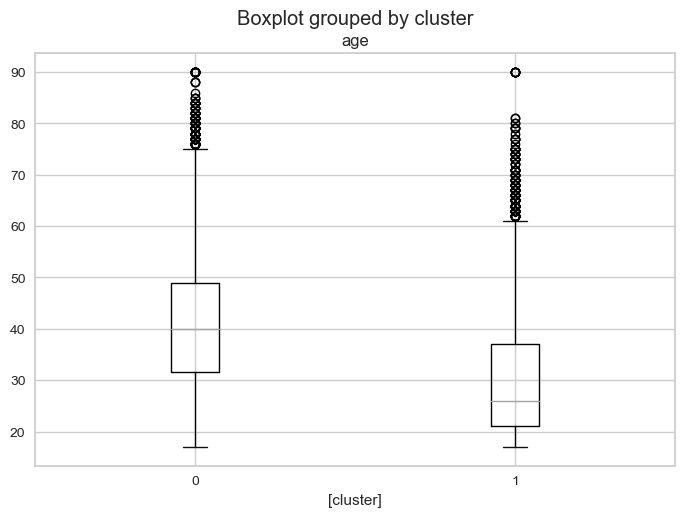

In [71]:
gmmAnal2.loc[:,['age', 'cluster']].boxplot(by = 'cluster')

<AxesSubplot:title={'center':'hours-per-week'}, xlabel='[cluster]'>

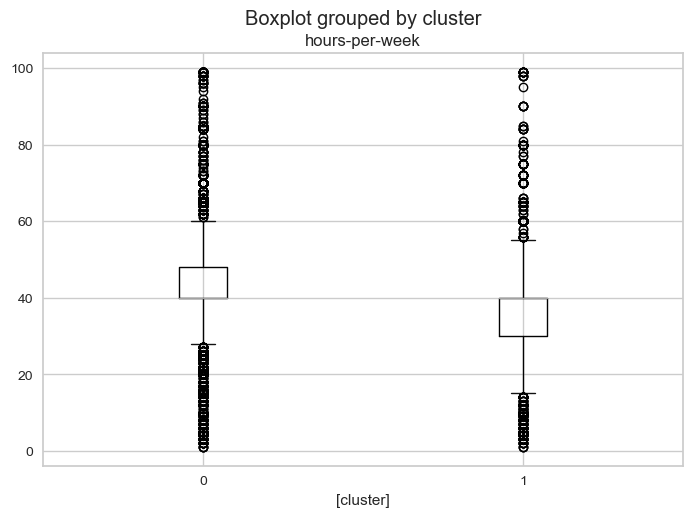

In [72]:
gmmAnal2.loc[:,['hours-per-week', 'cluster']].boxplot(by = 'cluster')

<AxesSubplot:xlabel='cluster', ylabel='hours-per-week'>

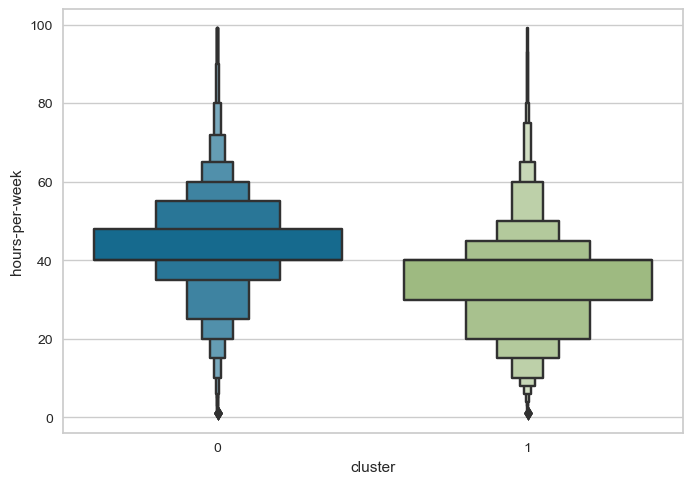

In [73]:
sns.boxenplot(data=gmmAnal2, x= 'cluster', y= 'hours-per-week')

In [74]:
from sklearn.metrics import classification_report
print(classification_report(adult.income, gmmAnal2.cluster))

              precision    recall  f1-score   support

           0       0.69      0.69      0.69     22654
           1       0.05      0.05      0.05      7508

    accuracy                           0.53     30162
   macro avg       0.37      0.37      0.37     30162
weighted avg       0.53      0.53      0.53     30162



In [75]:
reverseClusterGmm = gmmAnal2.copy()

In [76]:
reverseClusterGmm['cluster'] = reverseClusterGmm['cluster'].replace({1: 0, 0: 1})

In [77]:
print(classification_report(adult.income, reverseClusterGmm.cluster))

              precision    recall  f1-score   support

           0       0.95      0.31      0.47     22654
           1       0.31      0.95      0.47      7508

    accuracy                           0.47     30162
   macro avg       0.63      0.63      0.47     30162
weighted avg       0.79      0.47      0.47     30162



###### PCA

In [78]:
from sklearn.decomposition import PCA
def PCADimentionReduction(frame, n):
    pca = PCA(n_components=n)
    pca.fit(frame)
    return pca.transform(frame)

In [79]:
pca = PCA()
scaler = StandardScaler()
X_std = scaler.fit_transform(adultX_trans)
pca.fit(X_std)
pca.explained_variance_ratio_

array([5.10930811e-02, 3.00676646e-02, 2.89253462e-02, 2.30434567e-02,
       2.07037573e-02, 1.97139776e-02, 1.86001461e-02, 1.66975597e-02,
       1.54536088e-02, 1.42723534e-02, 1.41294522e-02, 1.39400985e-02,
       1.35176078e-02, 1.32080197e-02, 1.31103263e-02, 1.28715067e-02,
       1.26520641e-02, 1.25729488e-02, 1.24260277e-02, 1.23269786e-02,
       1.22697598e-02, 1.21606355e-02, 1.20598198e-02, 1.20151477e-02,
       1.19303837e-02, 1.18572437e-02, 1.17520898e-02, 1.16296379e-02,
       1.16014725e-02, 1.15705481e-02, 1.14692017e-02, 1.14516276e-02,
       1.14232224e-02, 1.14119054e-02, 1.13967280e-02, 1.13905736e-02,
       1.13886064e-02, 1.13846163e-02, 1.13831135e-02, 1.13817366e-02,
       1.13797794e-02, 1.13773603e-02, 1.13754254e-02, 1.13726424e-02,
       1.13686171e-02, 1.13648961e-02, 1.13584894e-02, 1.13568591e-02,
       1.13487898e-02, 1.13307702e-02, 1.13175190e-02, 1.13049836e-02,
       1.12889802e-02, 1.12657905e-02, 1.12326218e-02, 1.12083847e-02,
      

In [156]:
pca.explained_variance_ratio_[:10].sum()

0.23857095153204308

In [155]:
PCA(n_components=10).fit(X_std).explained_variance_ratio_.sum()

0.23533928197960363

In [152]:
pca.explained_variance_ratio_[:67].sum()

0.9019059083421765

In [154]:
PCA(n_components=0.90).fit(X_std).explained_variance_ratio_.sum()

0.9019059083421765

In [81]:
pcaX = pca.transform(X_std)

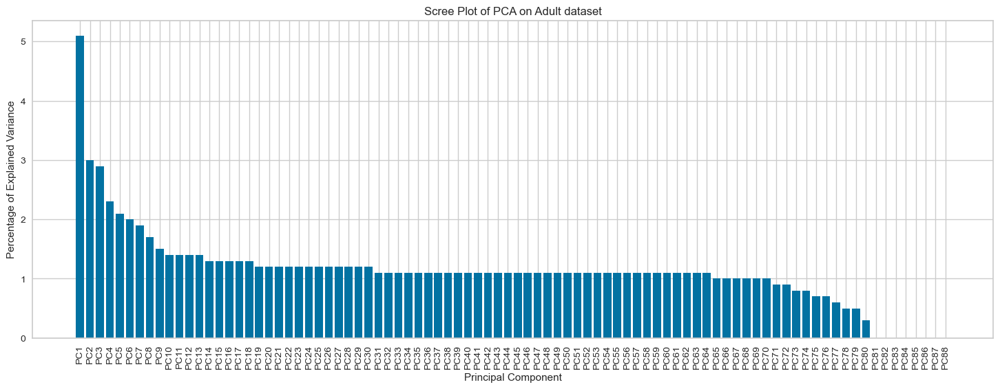

In [82]:
per_var = np.round(pca.explained_variance_ratio_* 100, decimals=1)
xlabels = ['PC' + str(x) for x in range(1, len(per_var)+1)]

fig = plt.figure(figsize=(18, 6))
plt.bar(x=range(1,len(per_var)+1), height=per_var, tick_label=xlabels)
plt.ylabel('Percentage of Explained Variance')
plt.xlabel('Principal Component')
plt.xticks(rotation=90)
plt.title('Scree Plot of PCA on Adult dataset')
plt.show()

###### applying silhouette score, at least one cluster failed to meet the average silhoeuette score for each n-clusters

###### same silhouette plots and average scores for pca data and rescaled data

For n_clusters = 2 The average silhouette_score is : 0.5224450251364515
For n_clusters = 3 The average silhouette_score is : 0.5247078429998273
For n_clusters = 4 The average silhouette_score is : 0.07837740690723538
For n_clusters = 5 The average silhouette_score is : 0.07905448976535943
For n_clusters = 6 The average silhouette_score is : 0.07628138324967548
For n_clusters = 7 The average silhouette_score is : 0.07849046191375901
For n_clusters = 8 The average silhouette_score is : 0.05242085863405493
For n_clusters = 9 The average silhouette_score is : 0.07312223041528577


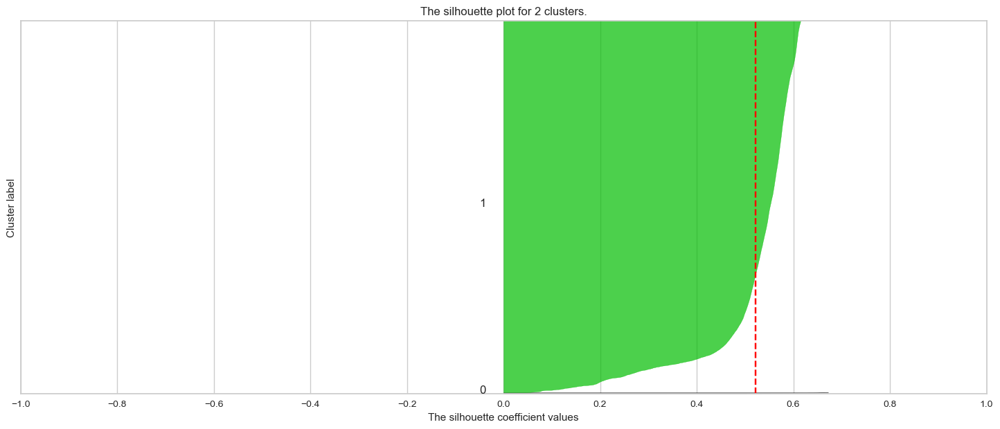

<Figure size 800x800 with 0 Axes>

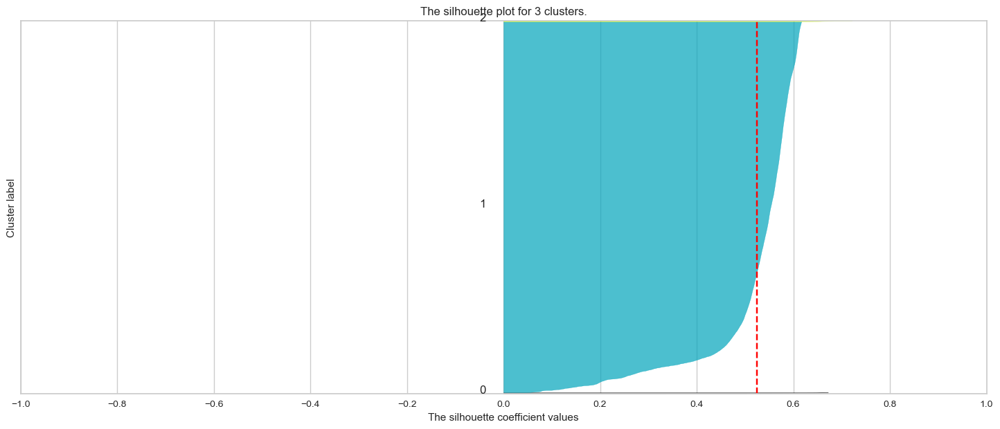

<Figure size 800x800 with 0 Axes>

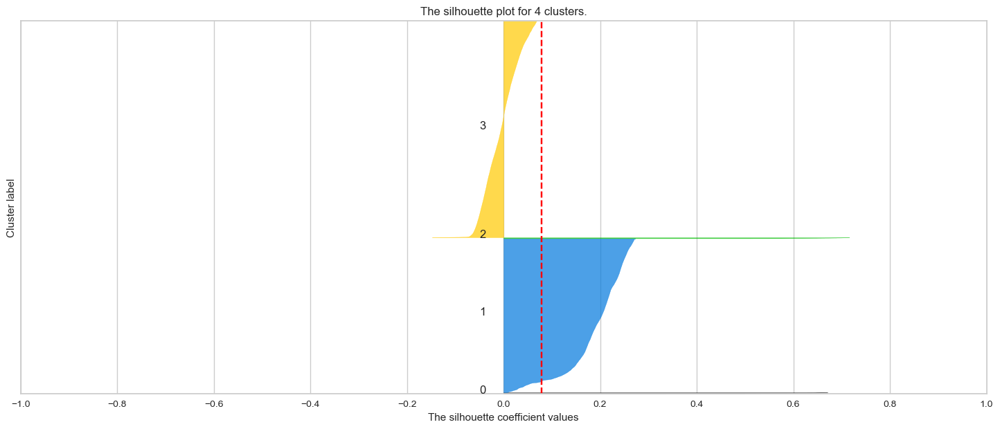

<Figure size 800x800 with 0 Axes>

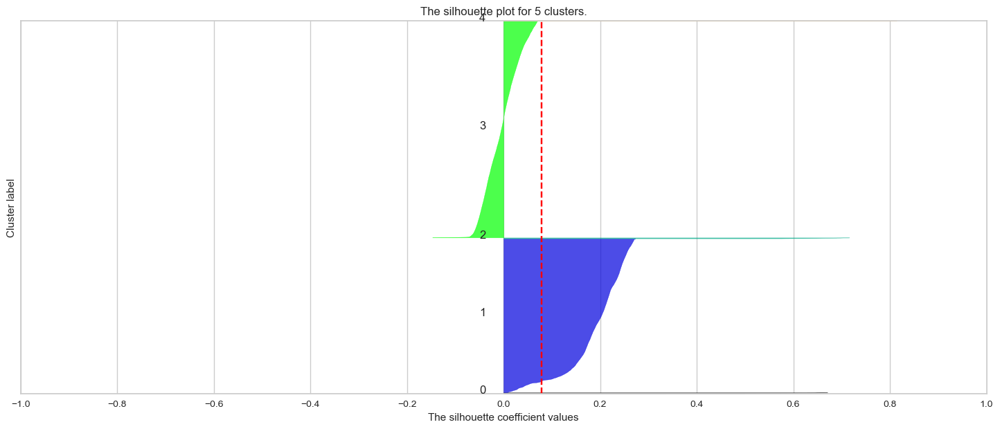

<Figure size 800x800 with 0 Axes>

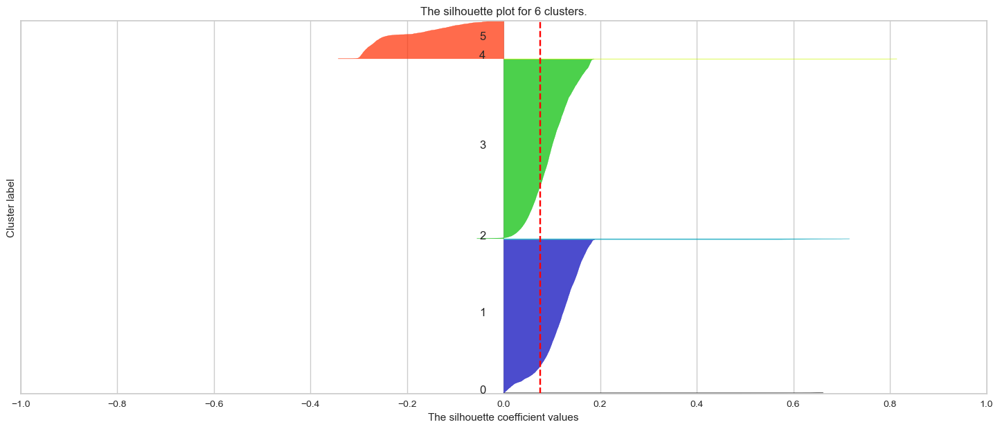

<Figure size 800x800 with 0 Axes>

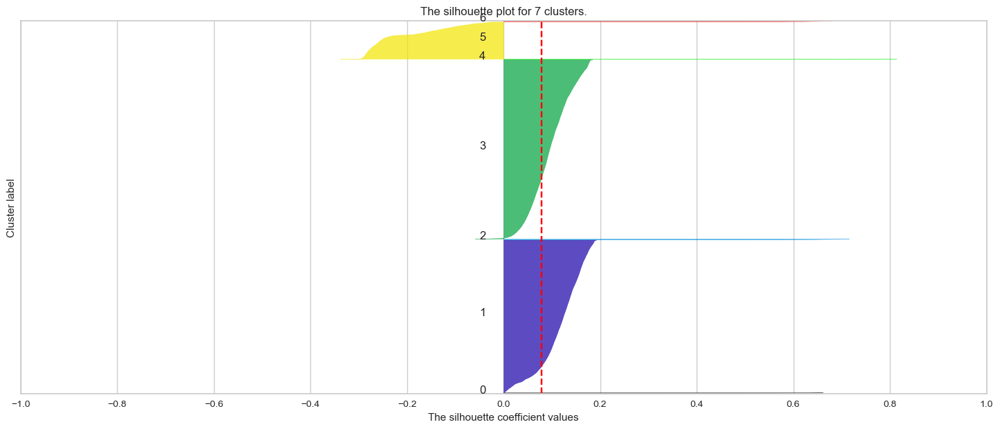

<Figure size 800x800 with 0 Axes>

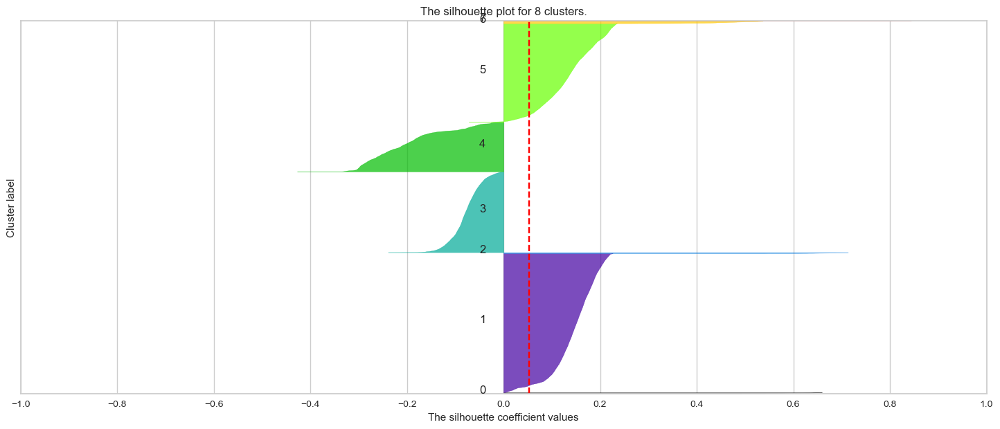

<Figure size 800x800 with 0 Axes>

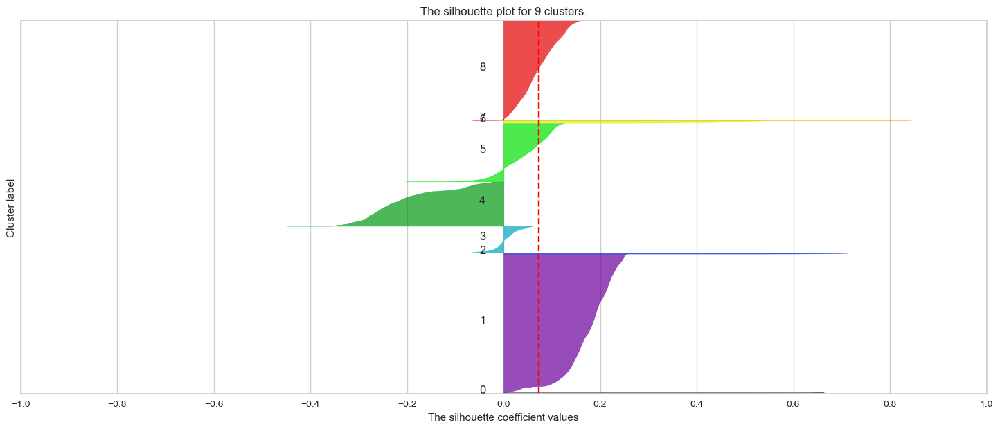

<Figure size 800x800 with 0 Axes>

In [84]:
silhouettePlotGMM(pcaX)

For n_clusters = 2 The average silhouette_score is : 0.5224450251364519
For n_clusters = 3 The average silhouette_score is : 0.5247078429998274
For n_clusters = 4 The average silhouette_score is : 0.07837740690723616
For n_clusters = 5 The average silhouette_score is : 0.07905448976536018
For n_clusters = 6 The average silhouette_score is : 0.07628138324967822
For n_clusters = 7 The average silhouette_score is : 0.0784904619137618
For n_clusters = 8 The average silhouette_score is : 0.05242085863405623
For n_clusters = 9 The average silhouette_score is : 0.07312223041528751


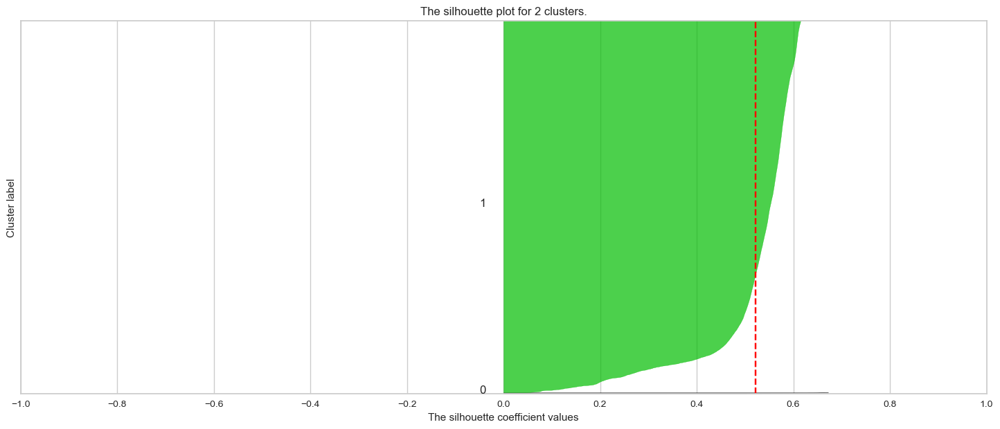

<Figure size 800x800 with 0 Axes>

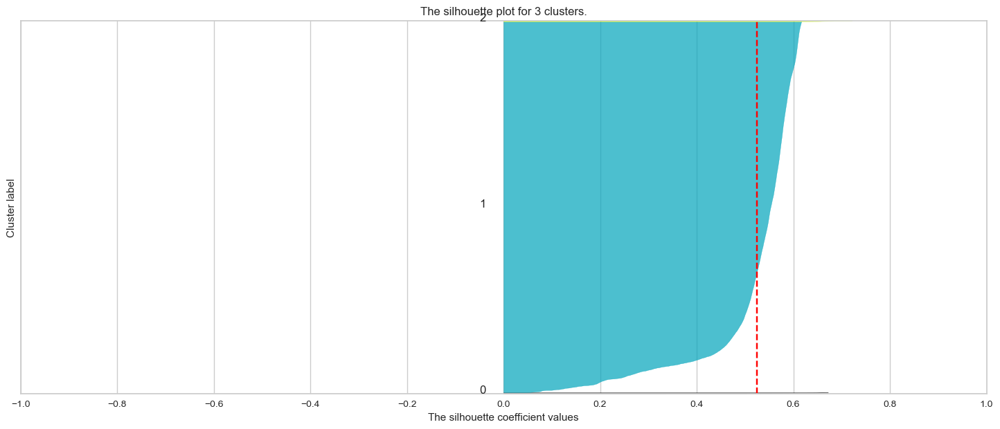

<Figure size 800x800 with 0 Axes>

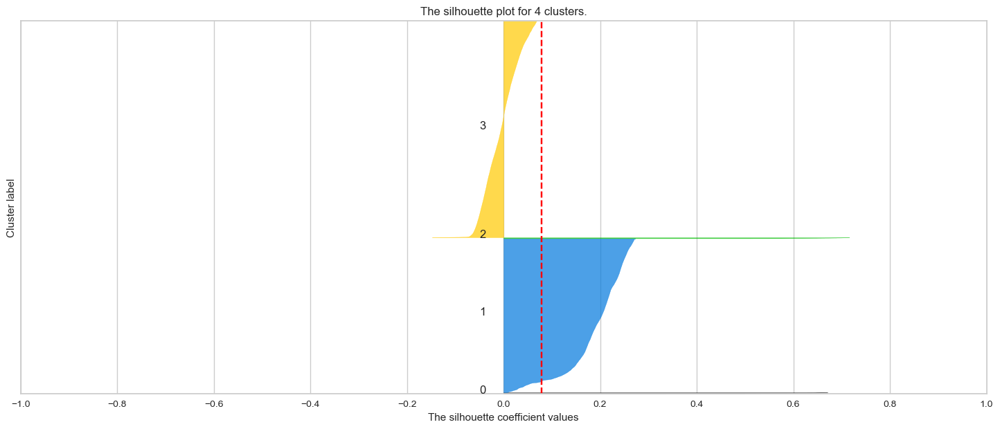

<Figure size 800x800 with 0 Axes>

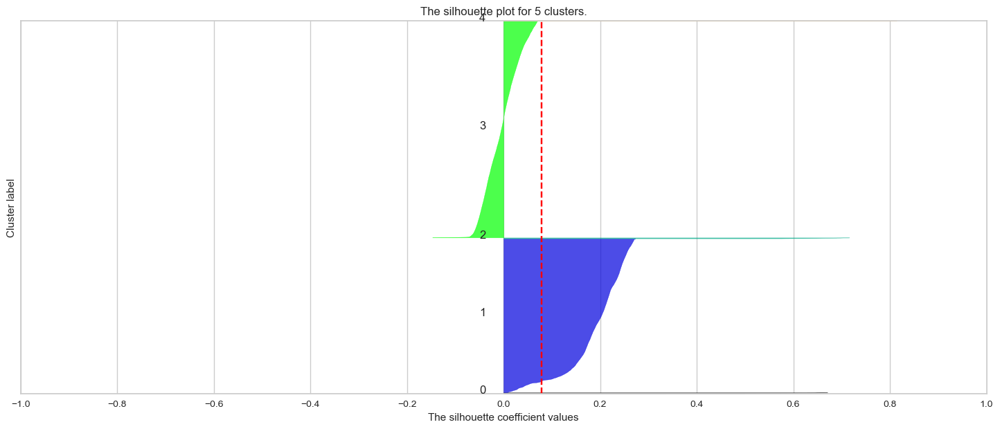

<Figure size 800x800 with 0 Axes>

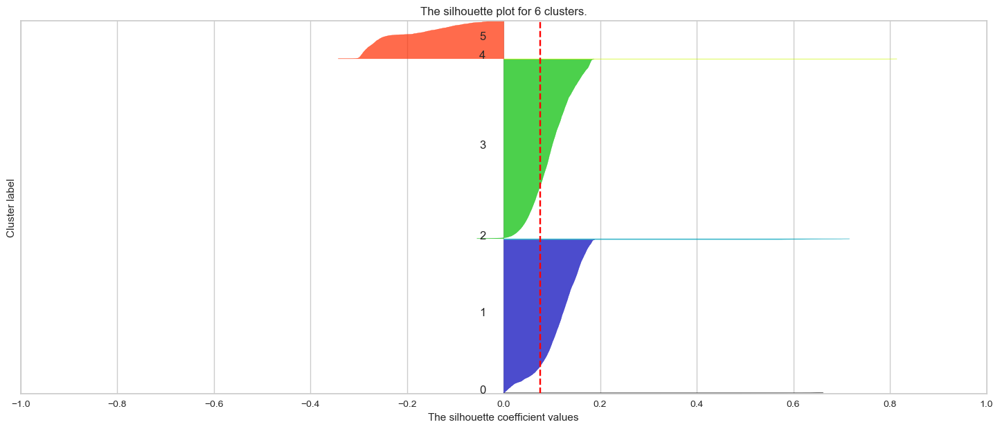

<Figure size 800x800 with 0 Axes>

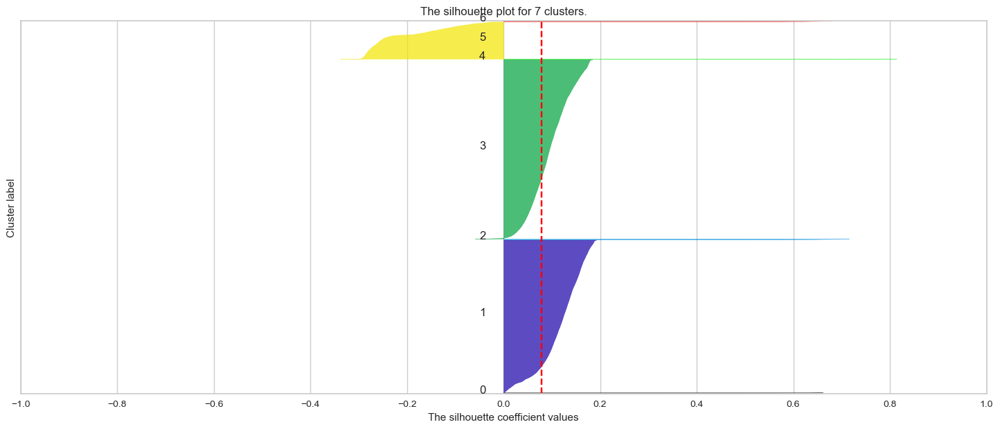

<Figure size 800x800 with 0 Axes>

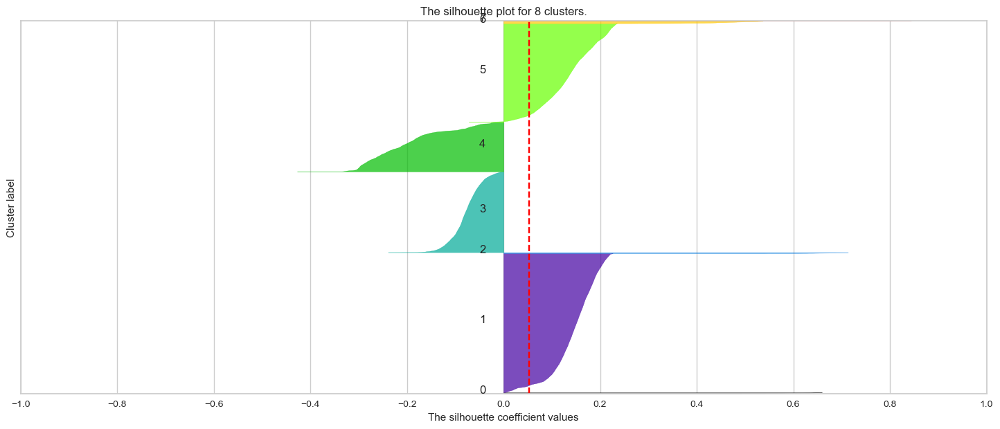

<Figure size 800x800 with 0 Axes>

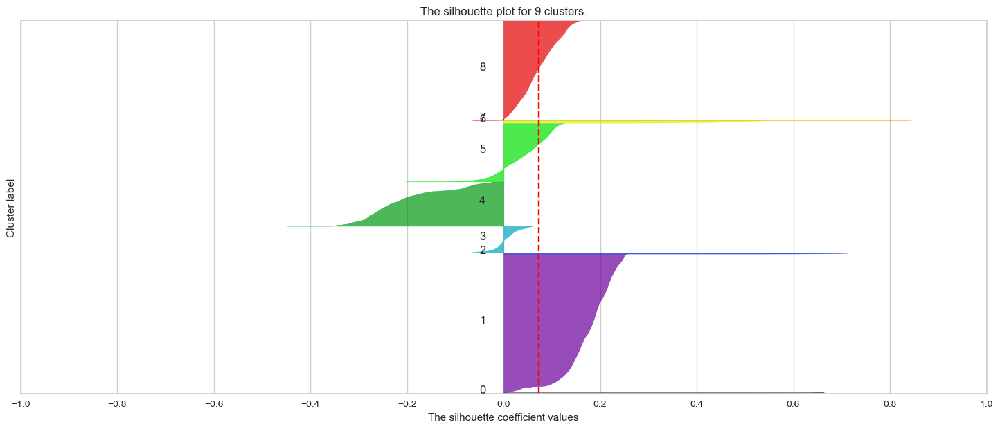

<Figure size 800x800 with 0 Axes>

In [122]:
silhouettePlotGMM(X_std)

In [165]:
gmmXpca = GaussianMixture(n_components=2, random_state=42)

gmmXpca.fit(pcaX)

labelsGXP = gmmXpca.predict(pcaX)

In [166]:
gmmXstd = GaussianMixture(n_components=2, random_state=42)
gmmXstd.fit(X_std)
labelsGXS = gmmXstd.predict(X_std)

In [167]:
sum(labelsGXP == labelsGXS)

30162

In [173]:
pca67 = PCA(n_components=67).fit_transform(X_std)
pca67.shape

(30162, 67)

In [174]:
gmmX67 = GaussianMixture(n_components=2, random_state=42)

gmmX67.fit(pca67)

labelsGX67 = gmmX67.predict(pca67)

In [175]:
sum(labelsGX67 == labelsGXS)

30162

In [182]:
sum(GaussianMixture(n_components=3, random_state=42).fit(X_std).predict(X_std) ==\
    GaussianMixture(n_components=3, random_state=42).fit(pca67).predict(pca67))

12343

In [201]:
dict1 = {0:0, 1:0, 2:0}
for i in GaussianMixture(n_components=3, random_state=42).fit(X_std).predict(X_std):
    dict1[i]+=1

In [202]:
dict1

{0: 80, 1: 30014, 2: 68}

In [188]:
dict2 = {0:0, 1:0, 2:0}
for i in GaussianMixture(n_components=3, random_state=42).fit(pca67).predict(pca67):
    dict2[i]+=1

In [189]:
dict2

{0: 80, 1: 12277, 2: 17805}

###### labels are different from before pca was applied (using same scaled data)

###### possible reason "...the transformation by PCA can change the relative distances between data points and the shape of the clusters"

In [84]:
labels.sum()

7371

In [85]:
(labels == labelsGXP).sum()

7291

###### majority class in gmm before pca had 22791 instances

###### majority class in gmm after pca has 29778 instances

In [86]:
gmmAnal2.cluster.value_counts()

0    22791
1     7371
Name: cluster, dtype: int64

In [87]:
adult.income.value_counts()

0    22654
1     7508
Name: income, dtype: int64

In [88]:
sum([i==0 for i in labelsGXP])/len(labelsGXP)

0.0026523440090179696

###### swapping labels so the majority label will be '0' in both clusters

###### 22765 datapoints retaining their place in the majority class 

In [89]:
labels_swapped = np.logical_not(labels).astype(int)

In [90]:
sum(labels_swapped == labelsGXP)

22871

In [91]:
pcaX[:, :2]

array([[ 0.81623884, -1.49489068],
       [-2.65549256, -1.29456047],
       [ 0.72609618,  0.24373005],
       ...,
       [ 2.38965298, -2.47705001],
       [ 1.88092454,  1.42387199],
       [-0.66570022, -2.87238129]])

In [195]:
df_67 = pd.DataFrame(pca67, columns=['PC{}'.format(i) for i in range(1,68)])
df_67['cluster'] = GaussianMixture(n_components=3, random_state=42).fit(pca67).predict(pca67)

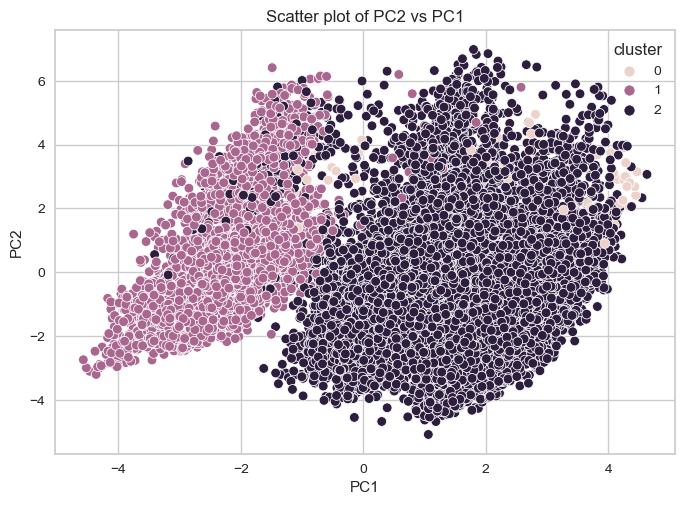

In [196]:
import matplotlib.pyplot as plt

sns.scatterplot(data=df_67, x='PC1', y='PC2', hue='cluster')


# set the title and axis labels
plt.title('Scatter plot of PC2 vs PC1')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend(title='cluster', loc='upper right')
# display the plot
plt.show()

In [92]:
df_pca = pd.DataFrame(pcaX, columns=['PC{}'.format(i) for i in range(1,89)])
df_pca['cluster'] = labelsGXP

In [93]:
df_pca['income'] =adult.income

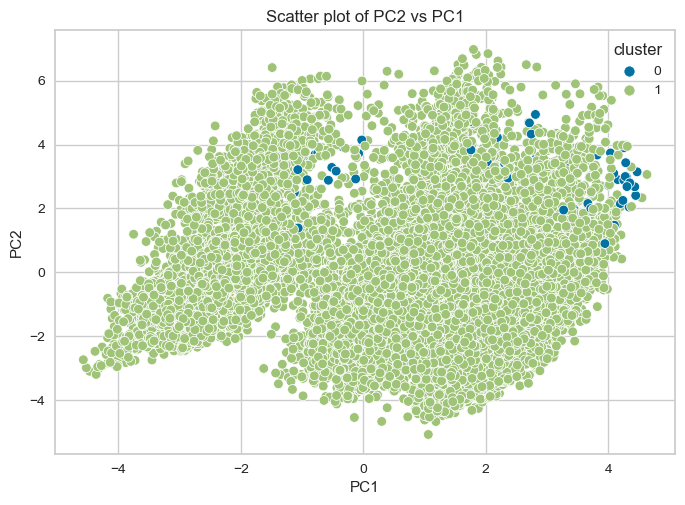

In [94]:
import matplotlib.pyplot as plt

sns.scatterplot(data=df_pca, x='PC1', y='PC2', hue='cluster')


# set the title and axis labels
plt.title('Scatter plot of PC2 vs PC1')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend(title='cluster', loc='upper right')
# display the plot
plt.show()

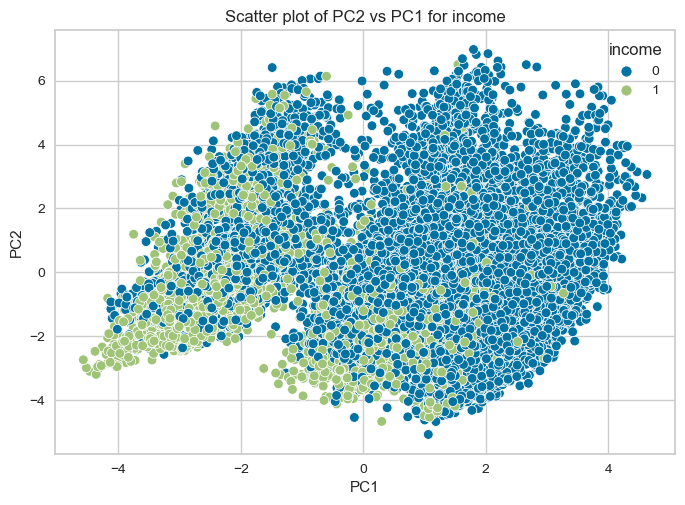

In [203]:
sns.scatterplot(data=df_pca, x='PC1', y='PC2', hue='income')


# set the title and axis labels
plt.title('Scatter plot of PC2 vs PC1 for income')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend(title='income', loc='upper right')
# display the plot
plt.show()

###### kmeans?, reduce dimensions

###### ICA

 with max_iter = 1000 and tol = 0.001, FastICA did not converge meaning it did not find a stable solution

 like in the pca, at least one cluster does not reach the average silhouette score. all plots have clusters that have some or all of their instances in the negative region


In [242]:
from sklearn.decomposition import FastICA

# Assume that X is your feature matrix

# Apply ICA to the features
ica = FastICA()  # Choose the number of components you want to keep
X_ica = ica.fit_transform(X_std)

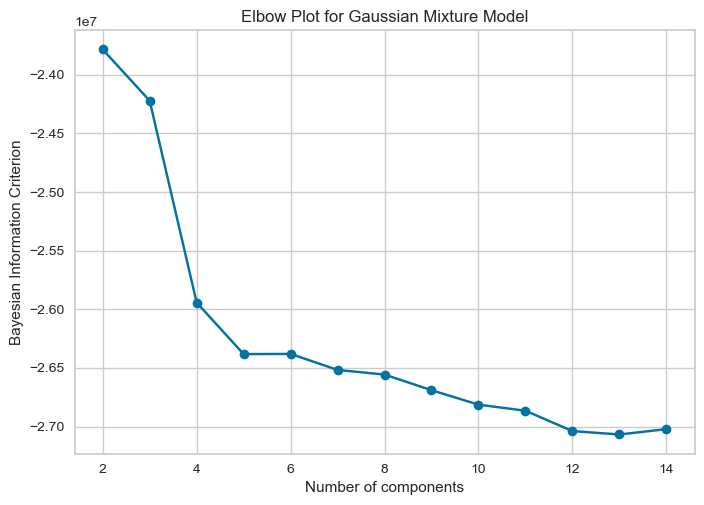

In [234]:
elbowPlotGMM(X_ica)

For n_clusters = 2 The average silhouette_score is : 0.5254586335818012
For n_clusters = 3 The average silhouette_score is : 0.5093985234958426
For n_clusters = 4 The average silhouette_score is : 0.4722003770400449
For n_clusters = 5 The average silhouette_score is : 0.3042485840101375
For n_clusters = 6 The average silhouette_score is : 0.1481733244732985
For n_clusters = 7 The average silhouette_score is : 0.1594341867674381
For n_clusters = 8 The average silhouette_score is : 0.1398925614208389
For n_clusters = 9 The average silhouette_score is : 0.11265512170431723


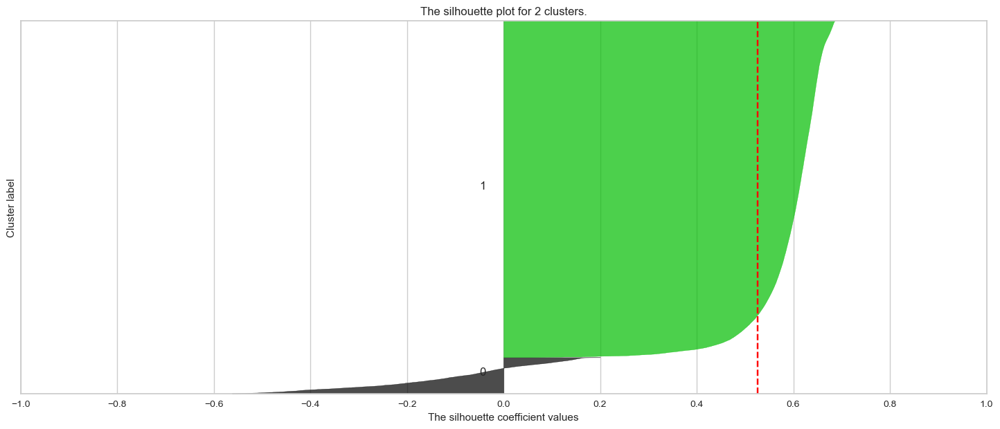

<Figure size 800x800 with 0 Axes>

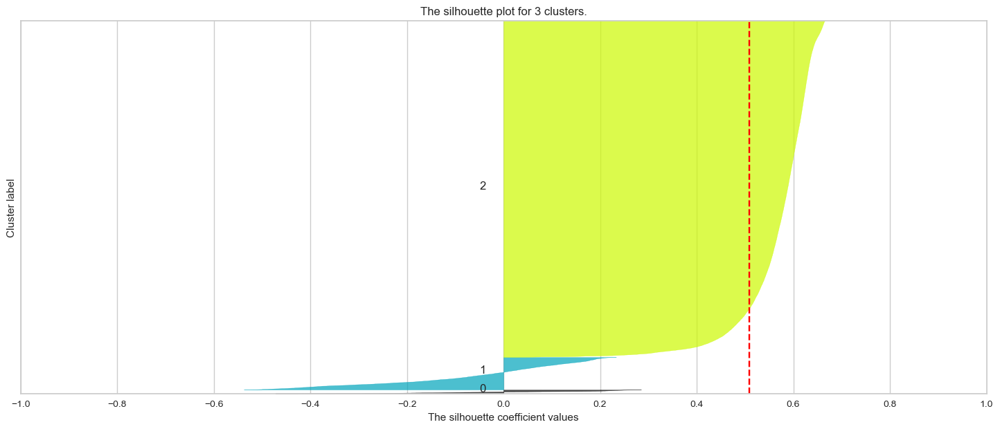

<Figure size 800x800 with 0 Axes>

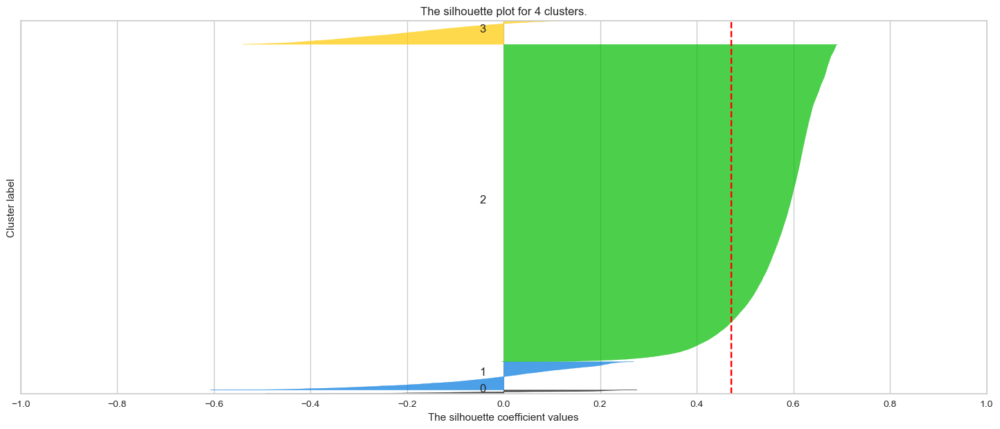

<Figure size 800x800 with 0 Axes>

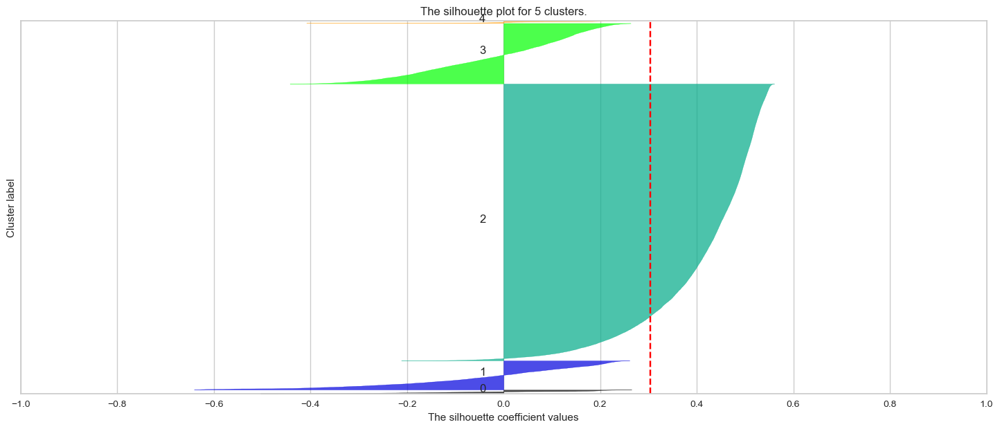

<Figure size 800x800 with 0 Axes>

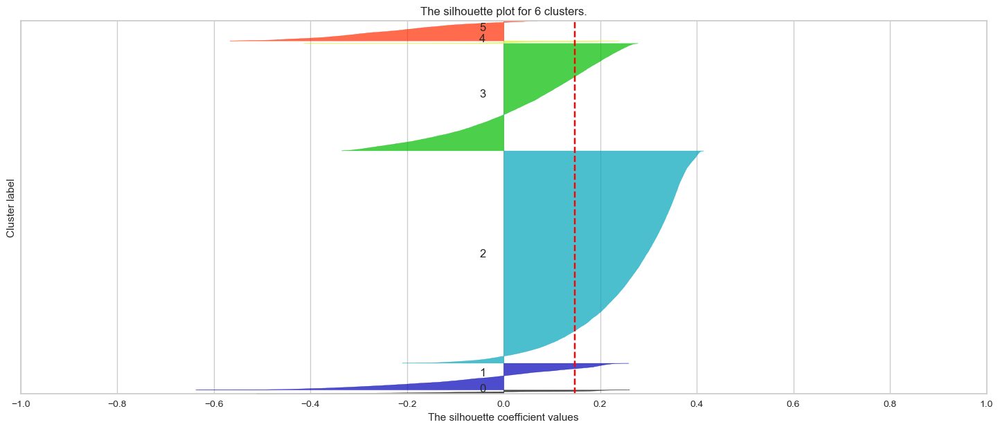

<Figure size 800x800 with 0 Axes>

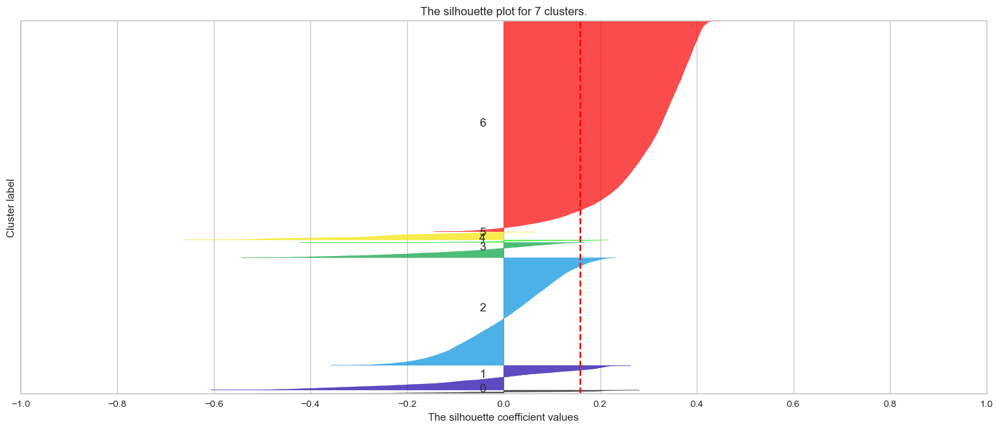

<Figure size 800x800 with 0 Axes>

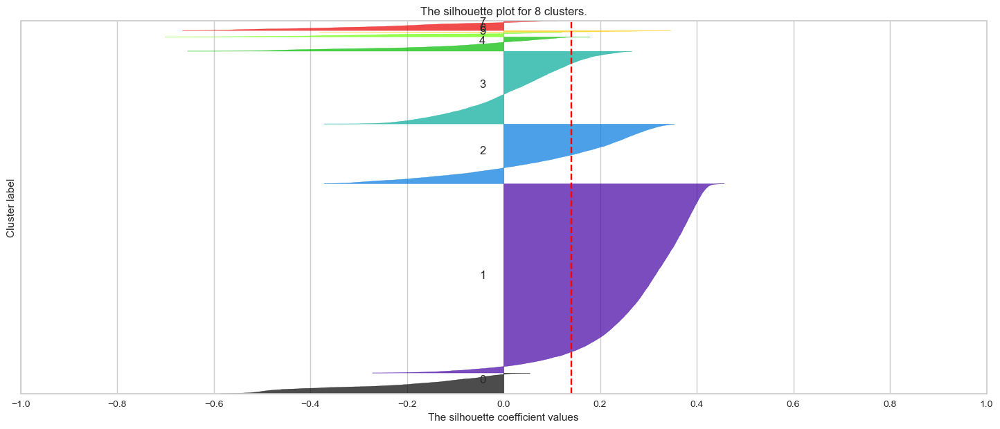

<Figure size 800x800 with 0 Axes>

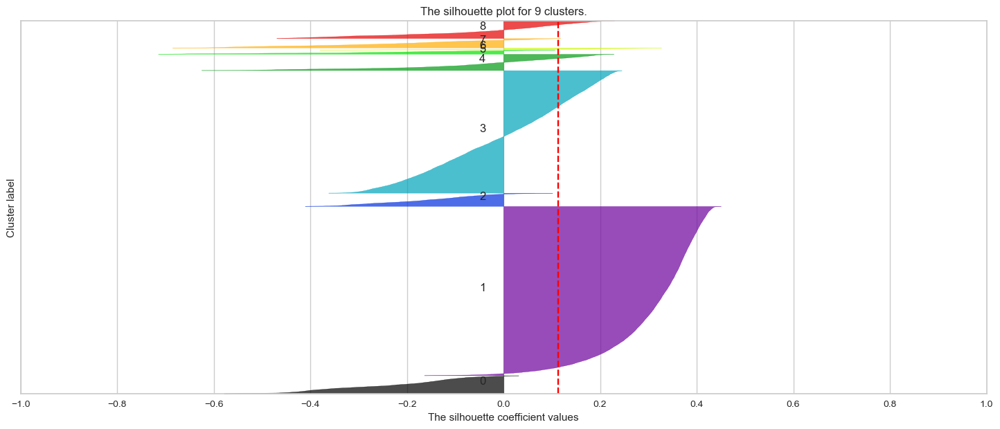

<Figure size 800x800 with 0 Axes>

In [228]:
silhouettePlotGMM(X_ica)

In [248]:
gmmXica = GaussianMixture(n_components=2, random_state=42)

gmmXica.fit(X_ica)

labelsGXI = gmmXica.predict(X_ica)

In [249]:
sum(labelsGXI == labelsGXS)

27317

In [250]:
sum([i==1 for i in labelsGXI])/len(labelsGXI)

0.9030236721702805

###### kurtosis

In [251]:
from scipy.stats import kurtosis
kurt = kurtosis(X_ica)

In [252]:
np.argsort(kurt)[::-1]

array([77, 55, 56, 80, 12, 33, 50, 72, 68, 37, 26,  6, 53, 64, 36,  4, 21,
       22,  7,  3, 25, 32, 42, 63, 40, 71, 78,  0, 81, 17, 43, 41, 75, 38,
       84, 67, 14, 34, 15, 13, 19, 10, 58, 70, 74, 11, 73, 52, 85, 62, 60,
        1, 66, 28, 57, 61, 79, 23, 82, 44, 46,  2, 51, 76, 35, 87, 83, 27,
       49, 69, 29,  8, 45, 16, 47, 31, 18,  9, 39, 30, 20,  5, 65, 24, 86,
       59, 48, 54], dtype=int64)

In [253]:
kurt

array([ 37.61740128,  22.73970865,  18.44342943,  41.1852864 ,
        45.92663755,  11.79474445,  55.77029193,  45.10706519,
        14.58435544,  12.91570661,  26.31510587,  24.5838146 ,
        68.03445126,  27.48408053,  30.38008843,  27.56667421,
        13.79853332,  36.10462384,  12.95118372,  26.98976406,
        12.40414675,  45.64248731,  45.37981985,  18.91760025,
         9.79927997,  39.52276031,  57.56932801,  16.40375754,
        21.05895605,  15.06768318,  12.41705723,  13.05474715,
        39.33579307,  65.27770745,  27.78863082,  17.73980867,
        49.17189757,  59.05571056,  32.09736249,  12.7744449 ,
        38.70013279,  33.77196632,  39.33179343,  35.08765479,
        18.85478192,  13.86122308,  18.60517742,  13.46167618,
         7.51456003,  16.33751865,  62.98523223,  18.31452786,
        23.8248575 ,  50.78224949,   7.22690067,  89.62674553,
        82.35967609,  20.45108599,  25.85640714,   8.67580096,
        22.84428096,  20.36575744,  23.24711232,  39.19

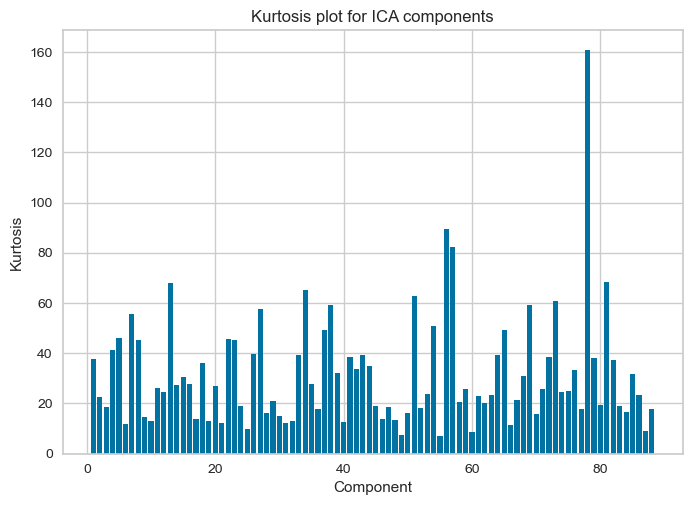

In [256]:
fig, ax = plt.subplots()
ax.bar(np.arange(1, len(kurt)+1), kurt)
ax.set_xlabel('Component')
ax.set_ylabel('Kurtosis')
ax.set_title('Kurtosis plot for ICA components')
plt.show()

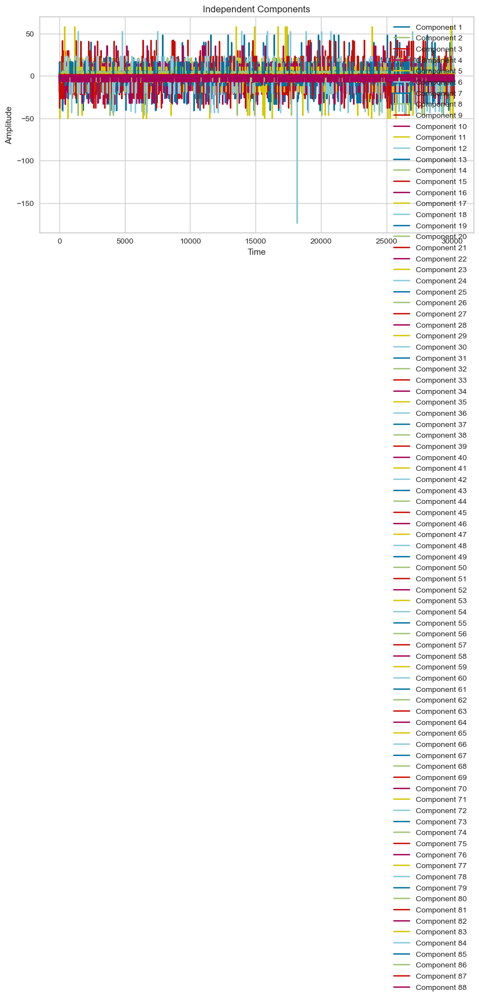

In [103]:
import matplotlib.pyplot as plt



# Plot the independent components
plt.figure(figsize=(10,5))
plt.title('Independent Components')
plt.xlabel('Time')
plt.ylabel('Amplitude')
for i in range(X_ica.shape[1]):
    plt.plot(X_ica[:,i], label='Component {}'.format(i+1))
plt.legend()
plt.show()

# Umap

In [104]:
import tensorflow as ts

In [105]:
import umap.umap_ as umap

def UmapDimentionReduction(frame):
    manifold = umap.UMAP()
    return manifold.fit_transform(frame)

In [106]:
X_umap = UmapDimentionReduction(X_std)

In [107]:
xxx = adultTransDf.drop('cluster', axis=1)
xxx.head()

,standardscaler__age,standardscaler__fnlwgt,standardscaler__capital-gain,standardscaler__capital-loss,standardscaler__hours-per-week,onehotencoder__workclass_Federal-gov,onehotencoder__workclass_Local-gov,onehotencoder__workclass_Private,onehotencoder__workclass_Self-emp-inc,onehotencoder__workclass_Self-emp-not-inc,...,onehotencoder__native-country_Scotland,onehotencoder__native-country_South,onehotencoder__native-country_Taiwan,onehotencoder__native-country_Thailand,onehotencoder__native-country_Trinadad&Tobago,onehotencoder__native-country_United-States,onehotencoder__native-country_Vietnam,onehotencoder__native-country_Yugoslavia,minmaxscaler__education-num,income
0,0.042796,-1.062722,0.146092,-0.218586,-0.077734,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.800000,0
1,0.880288,-1.007871,-0.147445,-0.218586,-2.331531,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.800000,0
2,-0.033340,0.244693,-0.147445,-0.218586,-0.077734,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.533333,0
3,1.108695,0.425240,-0.147445,-0.218586,-0.077734,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.400000,0
4,-0.794697,1.406658,-0.147445,-0.218586,-0.077734,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.800000,0


In [465]:
# from umap import UMAP
import plotly.express as px



# df = px.data.iris()

features = xxx.loc[:, :'minmaxscaler__education-num']

umap_2d = umap.UMAP(n_components=2, init='random', random_state=0)
umap_3d = umap.UMAP(n_components=3, init='random', random_state=0)

proj_2d = umap_2d.fit_transform(features)
proj_3d = umap_3d.fit_transform(features)

fig_2d = px.scatter(
    proj_2d, x=0, y=1,
    color=xxx.income, labels={'color': 'income'}
)
fig_2d.update_layout(
    title={
        'text': "2D representation of original data with income as the hue",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        
    }, xaxis_title="dimension 1",
    yaxis_title="dimension 2")

fig_2d.show()


In [109]:
fig_3d = px.scatter_3d(
    proj_3d, x=0, y=1, z=2,
    color=xxx.income, labels={'color': 'income'}
)
fig_3d.update_traces(marker_size=5)
fig_3d.update_layout(
    title={
        'text': "3D representation of original data with income as the hue",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    }, scene=dict(
        xaxis_title="dimension 1",
    yaxis_title="dimension 2", zaxis_title="dimension 3"
    ))

fig_3d.show()

For n_clusters = 2 The average silhouette_score is : 0.41493413
For n_clusters = 3 The average silhouette_score is : 0.4122765
For n_clusters = 4 The average silhouette_score is : 0.3648714
For n_clusters = 5 The average silhouette_score is : 0.38230872
For n_clusters = 6 The average silhouette_score is : 0.42089644
For n_clusters = 7 The average silhouette_score is : 0.44546562
For n_clusters = 8 The average silhouette_score is : 0.41364735
For n_clusters = 9 The average silhouette_score is : 0.42947316


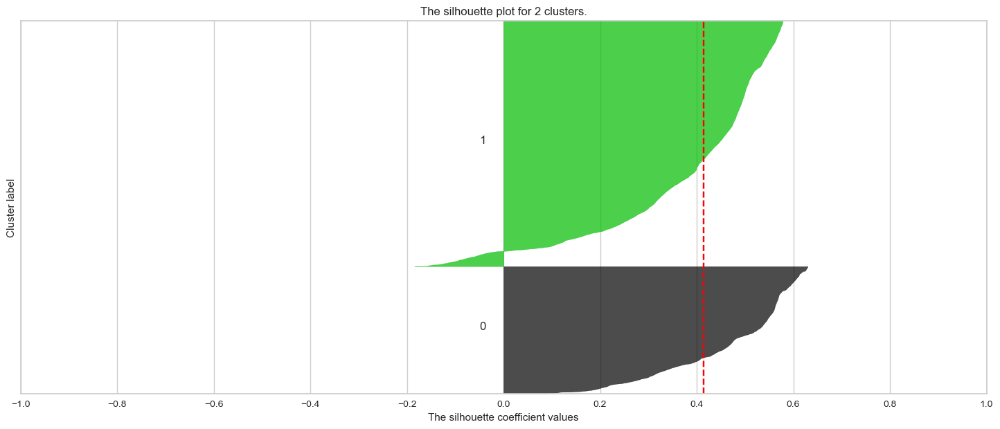

<Figure size 800x800 with 0 Axes>

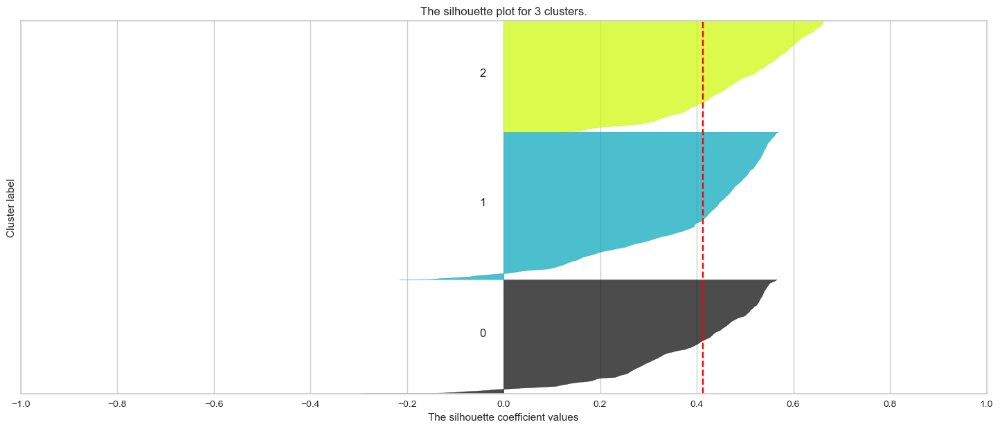

<Figure size 800x800 with 0 Axes>

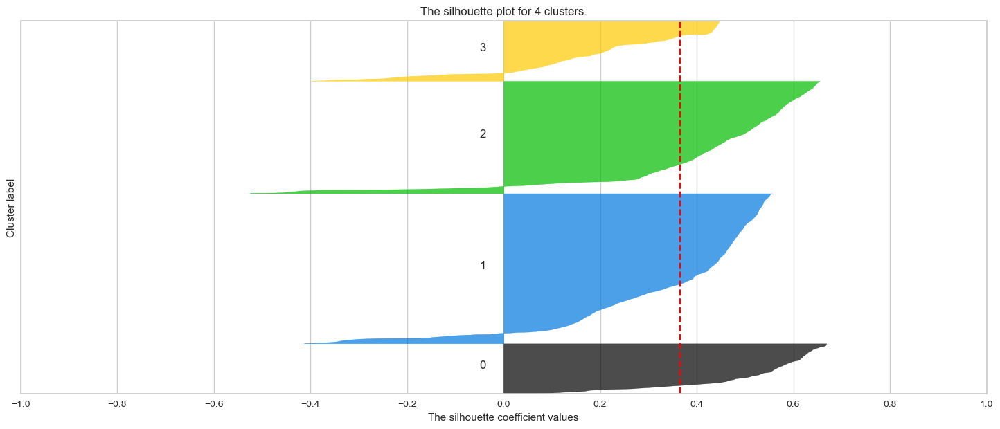

<Figure size 800x800 with 0 Axes>

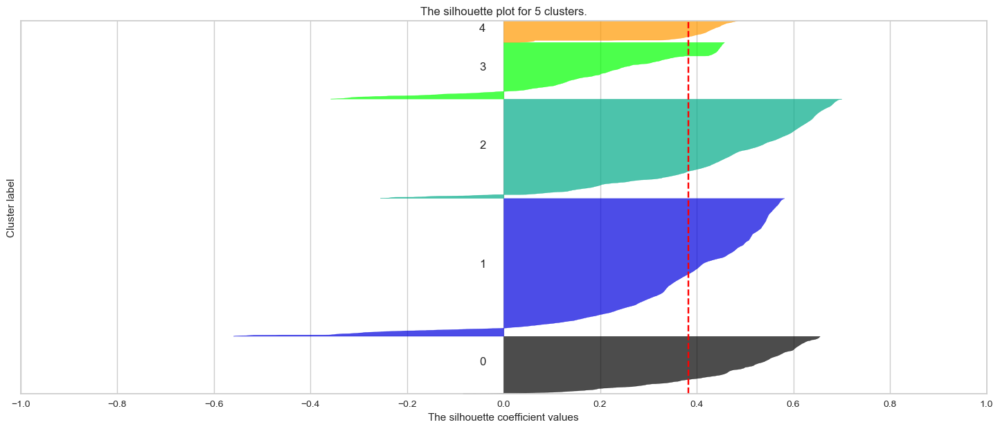

<Figure size 800x800 with 0 Axes>

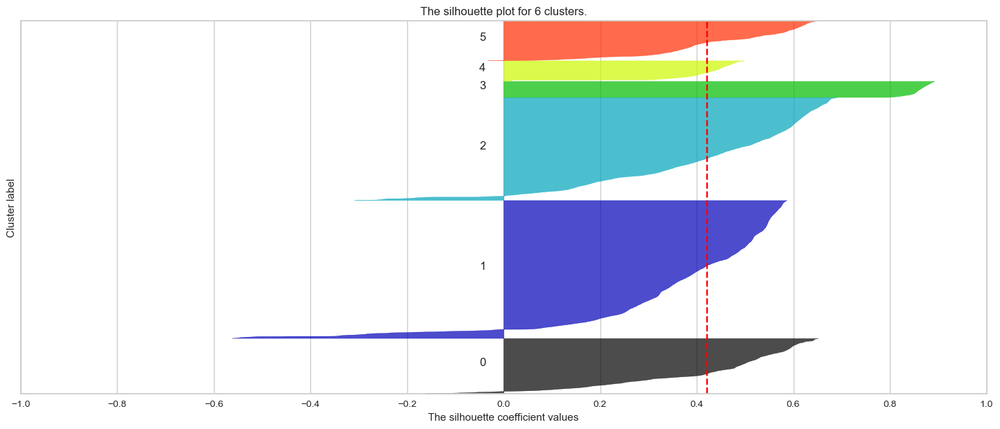

<Figure size 800x800 with 0 Axes>

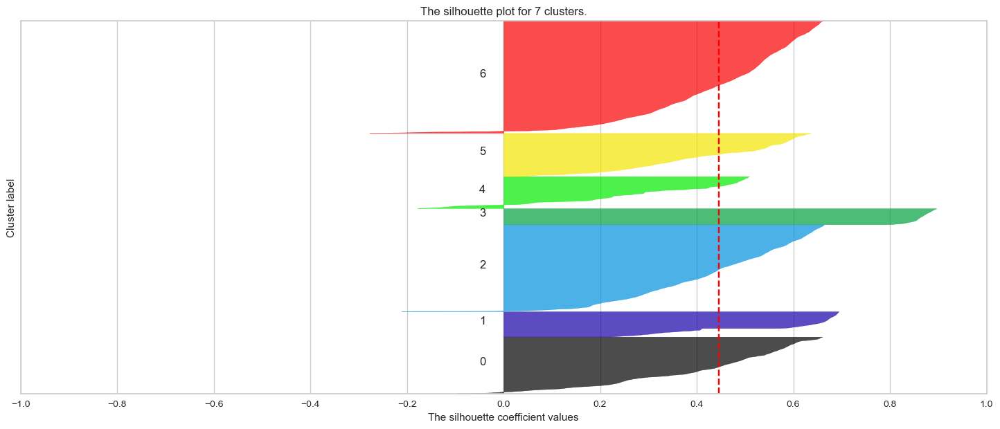

<Figure size 800x800 with 0 Axes>

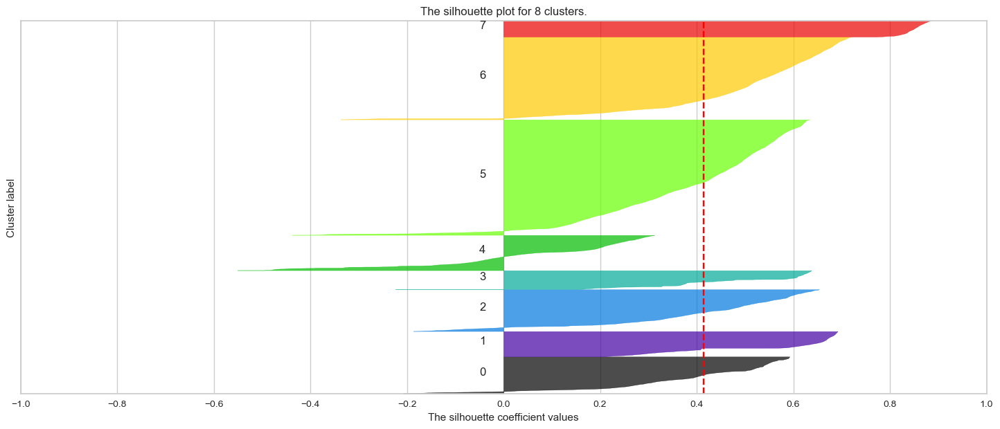

<Figure size 800x800 with 0 Axes>

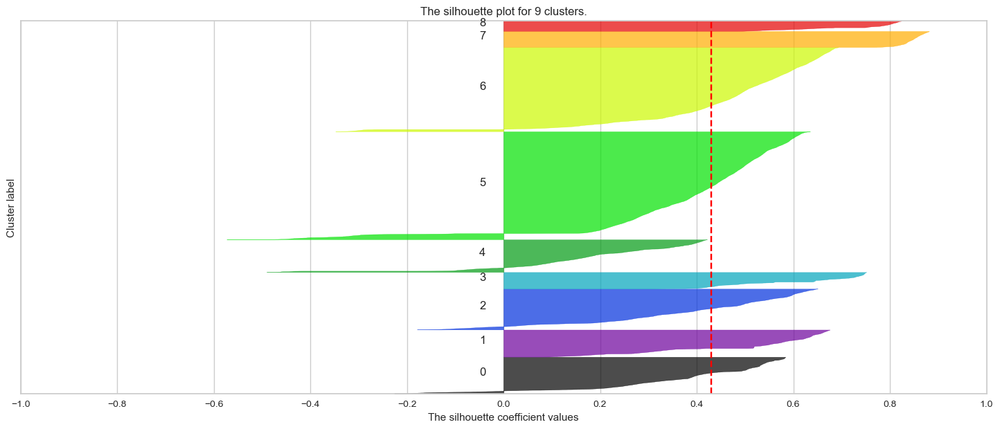

<Figure size 800x800 with 0 Axes>

In [110]:
silhouettePlotGMM(proj_2d)

For n_clusters = 2 The average silhouette_score is : 0.4151741
For n_clusters = 3 The average silhouette_score is : 0.45976883
For n_clusters = 4 The average silhouette_score is : 0.4966125
For n_clusters = 5 The average silhouette_score is : 0.5134861
For n_clusters = 6 The average silhouette_score is : 0.4760365
For n_clusters = 7 The average silhouette_score is : 0.47886828
For n_clusters = 8 The average silhouette_score is : 0.49582505
For n_clusters = 9 The average silhouette_score is : 0.36837968


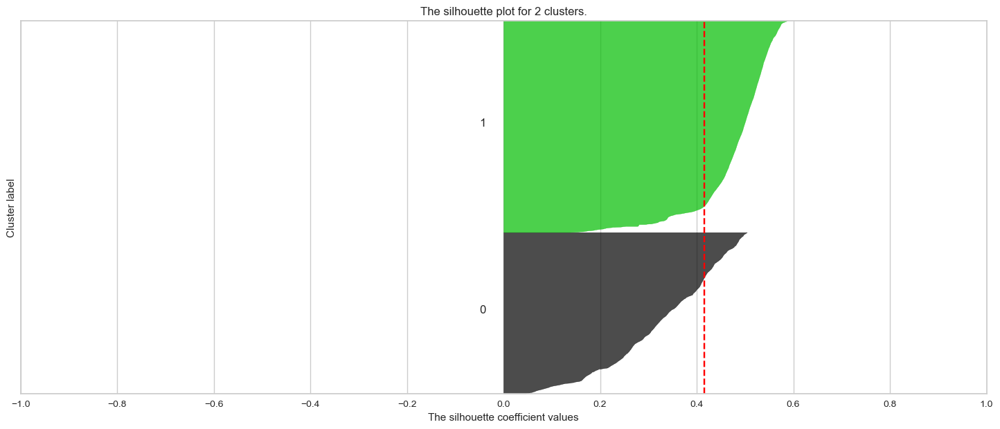

<Figure size 800x800 with 0 Axes>

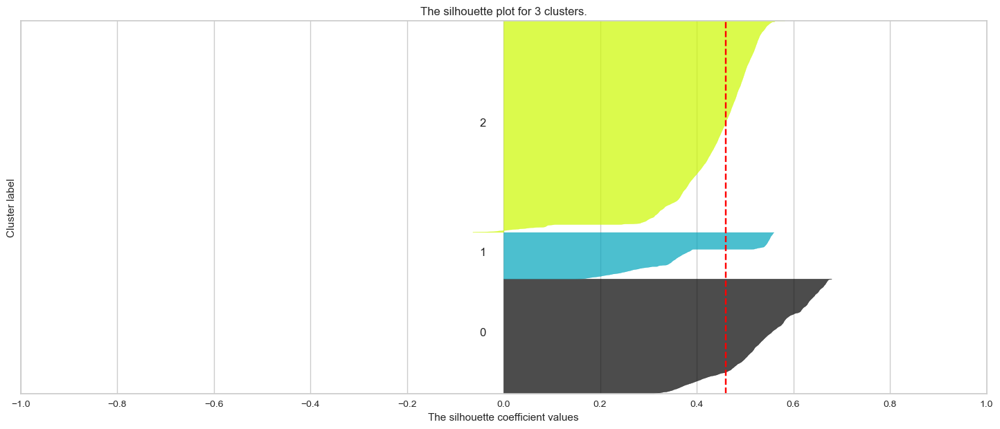

<Figure size 800x800 with 0 Axes>

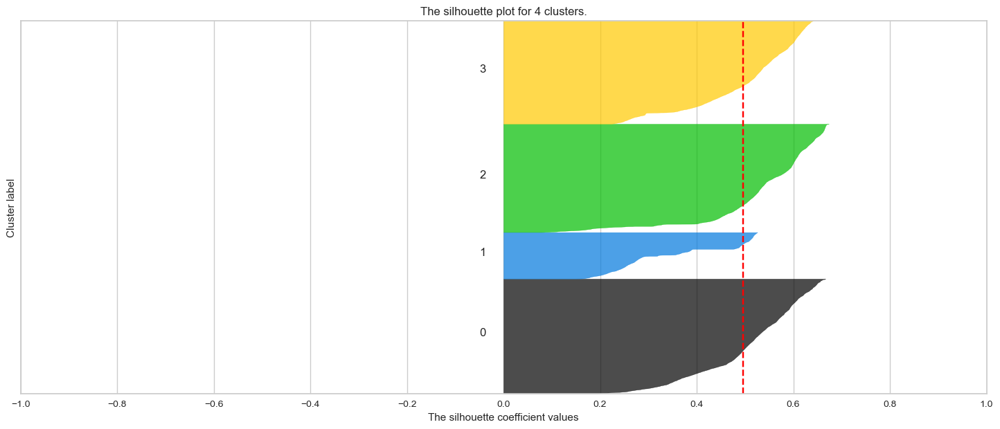

<Figure size 800x800 with 0 Axes>

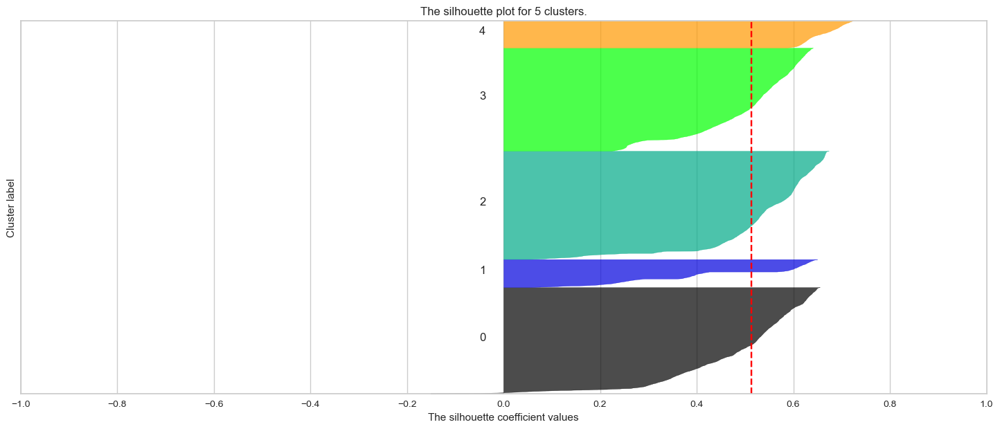

<Figure size 800x800 with 0 Axes>

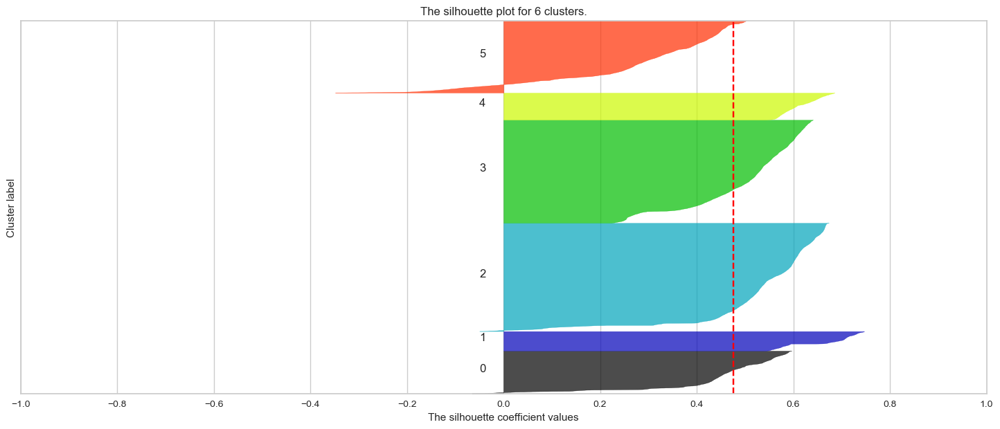

<Figure size 800x800 with 0 Axes>

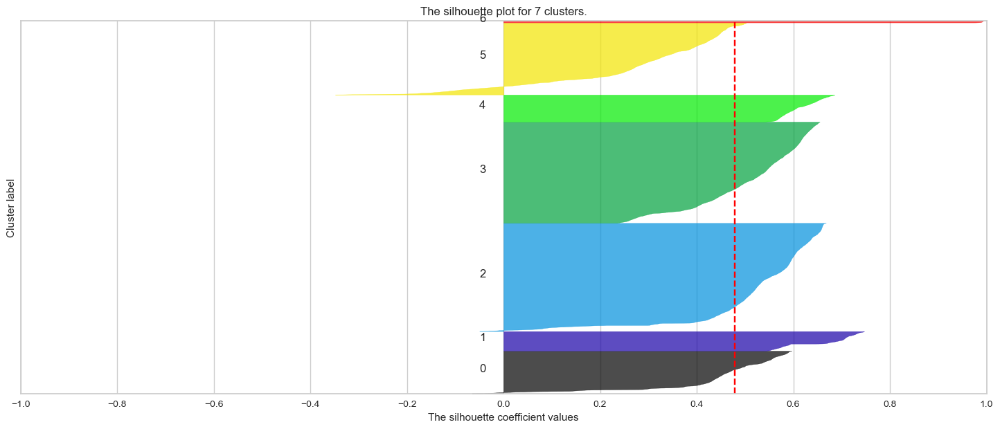

<Figure size 800x800 with 0 Axes>

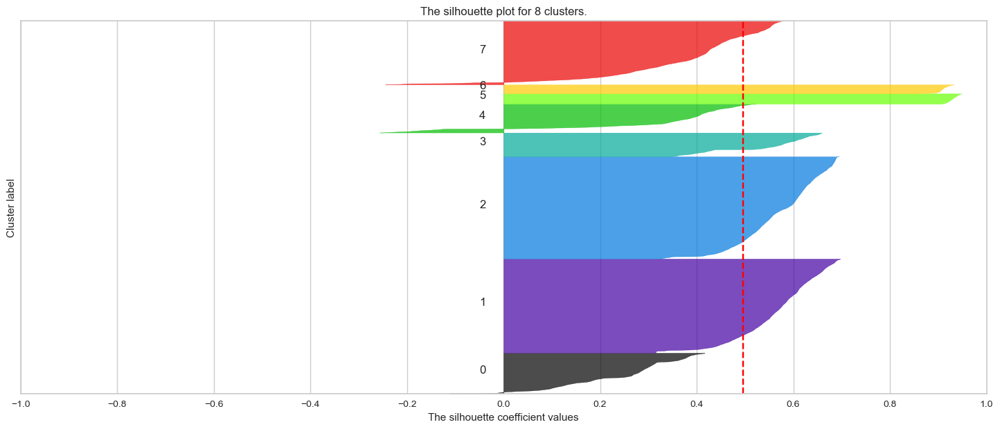

<Figure size 800x800 with 0 Axes>

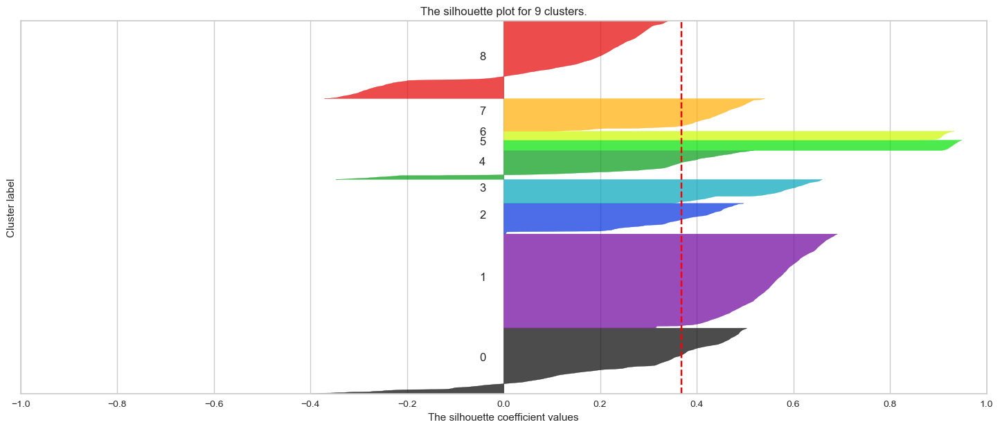

<Figure size 800x800 with 0 Axes>

In [111]:
silhouettePlotGMM(proj_3d)

In [267]:
gmmXumap = GaussianMixture(n_components=7, random_state=42)

gmmXumap.fit(proj_2d)

labelsGXU = gmmXumap.predict(proj_2d)

In [466]:
proj_2d.shape

(30162, 2)

In [467]:
df_umap = pd.DataFrame(proj_2d, columns=['component {}'.format(i) for i in [1,2]])
df_umap['cluster'] = labelsGXU
df_umap.head()

,component 1,component 2,cluster
0,7.993726,5.680761,2
1,1.733322,10.161842,0
2,8.466664,4.025598,2
3,3.047468,8.393461,0
4,8.013597,-5.483252,1


In [271]:
df_umap.cluster.value_counts()

6    9101
2    7039
0    4594
5    3501
4    2585
1    2043
3    1299
Name: cluster, dtype: int64

In [471]:
mapGMM2 = pd.DataFrame(proj_2d, columns=['component {}'.format(i) for i in [1,2]])
mapGMM2['cluster']  = GaussianMixture(n_components=2, random_state=42).fit(proj_2d).predict(proj_2d)
mapGMM2.head()

,component 1,component 2,cluster
0,7.993726,5.680761,1
1,1.733322,10.161842,0
2,8.466664,4.025598,1
3,3.047468,8.393461,0
4,8.013597,-5.483252,1


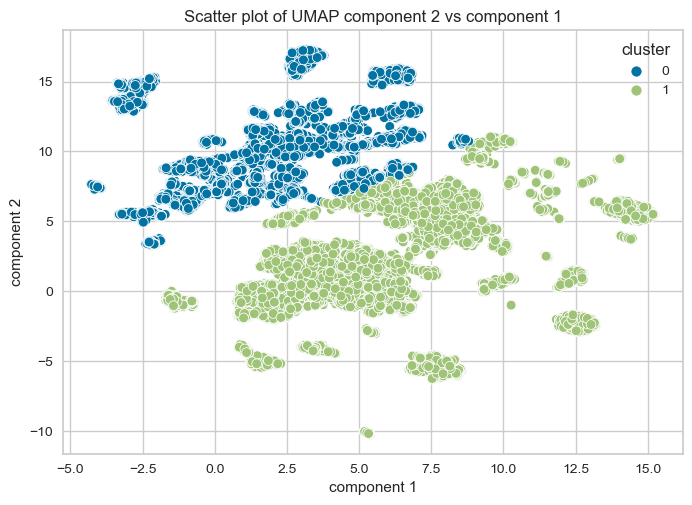

In [472]:
sns.scatterplot(data=mapGMM2, x='component 1', y='component 2', hue='cluster')


# set the title and axis labels
plt.title('Scatter plot of UMAP component 2 vs component 1')
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.legend(title='cluster', loc='upper right')
# display the plot
plt.show()

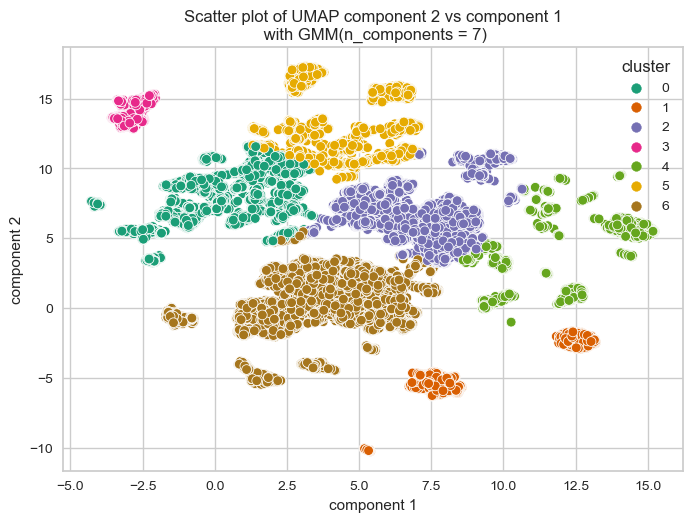

In [272]:
import matplotlib.pyplot as plt


colors = sns.color_palette('Dark2', n_colors=7)

sns.scatterplot(data=df_umap, x='component 1', y='component 2', hue='cluster',palette=colors)


# set the title and axis labels
plt.title('Scatter plot of UMAP component 2 vs component 1\n with GMM(n_components = 7)')
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.legend(title='cluster', loc='upper right')
# display the plot
plt.show()

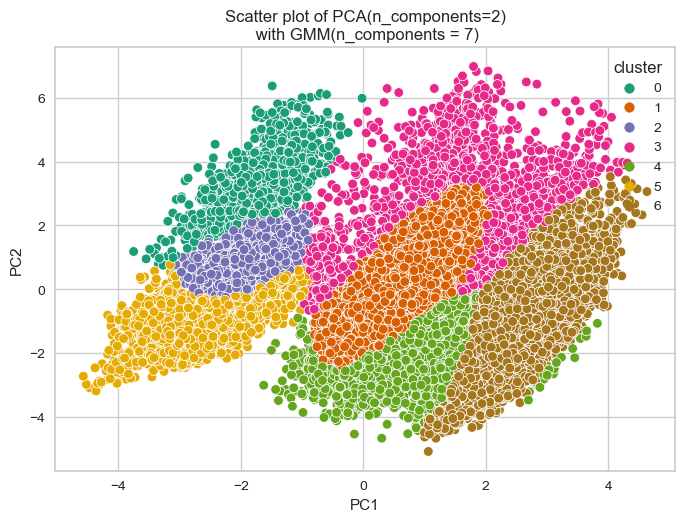

In [278]:
pca2 = PCA(n_components=2).fit_transform(X_std)
gmmX2 = GaussianMixture(n_components=7, random_state=42)

gmmX2.fit(pca2)

labelsGX2 = gmmX2.predict(pca2)

df_2 = pd.DataFrame(pca2, columns=['PC{}'.format(i) for i in range(1,3)])
df_2['cluster'] = labelsGX2


import matplotlib.pyplot as plt


colors = sns.color_palette('Dark2', n_colors=7)

sns.scatterplot(data=df_2, x='PC1', y='PC2', hue='cluster',palette=colors)


# set the title and axis labels
plt.title('Scatter plot of PCA(n_components=2)\n with GMM(n_components = 7)')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend(title='cluster', loc='upper right')
# display the plot
plt.show()

# NN

In [480]:
X = adult.drop('income', axis=1)
y = adult['income']

In [481]:
from sklearn.neural_network import MLPClassifier
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score


# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=26, stratify=y)

In [484]:
ct.fit(X_train)
X_train_trans = ct.transform(X_train)
print(X_train_trans.shape)

(24129, 87)


In [485]:
X_test_trans = ct.transform(X_test)

In [393]:
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import f1_score
from sklearn.model_selection import StratifiedKFold
from scipy.stats import randint

mlp = MLPClassifier()

param_dist = {
    'hidden_layer_sizes': [(10,), (50,), (100,)],
    'activation': ['relu', 'tanh', 'logistic'],
    'solver': ['adam', 'lbfgs'],
    'alpha': [0.0001, 0.001, 0.01, 0.1],
}



cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

random_search = RandomizedSearchCV(
    mlp, param_distributions=param_dist, n_iter=50,
    scoring='f1_micro', cv=cv, verbose=2, random_state=42, n_jobs=7
)
random_search.fit(X_train_trans, y_train)

print(random_search.best_params_)
print(random_search.best_score_)

Fitting 5 folds for each of 50 candidates, totalling 250 fits
{'solver': 'adam', 'hidden_layer_sizes': (100,), 'alpha': 0.1, 'activation': 'relu'}
0.8545734009864528


In [283]:
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import f1_score

# define the best parameters
best_params = {'solver': 'adam', 'hidden_layer_sizes': (100,), 'alpha': 0.1, 'activation': 'relu'}

# create the MLP classifier with the best parameters
mlp = MLPClassifier(**best_params)

# train the classifier on the entire dataset
mlp.fit(X_train_trans, y_train)

# use the classifier to make predictions on new data
mlp_pred = mlp.predict(X_test_trans)

In [284]:
from sklearn.metrics import confusion_matrix,ConfusionMatrixDisplay
cm_mlp = confusion_matrix(y_test, mlp_pred)
print("Confusion matrix:\n{}\n".format(cm_mlp))

print(classification_report(y_test, mlp_pred,
                            target_names=["<=50k", ">50k"]))

Confusion matrix:
[[4232  299]
 [ 563  939]]

              precision    recall  f1-score   support

       <=50k       0.88      0.93      0.91      4531
        >50k       0.76      0.63      0.69      1502

    accuracy                           0.86      6033
   macro avg       0.82      0.78      0.80      6033
weighted avg       0.85      0.86      0.85      6033



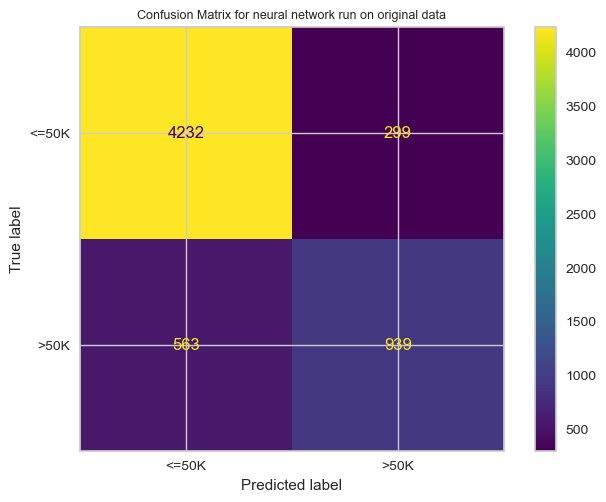

In [293]:
disp = ConfusionMatrixDisplay(confusion_matrix=cm_mlp,display_labels=["<=50K", ">50K"])

disp.plot()
plt.title('Confusion Matrix for neural network run on original data', fontsize=9)
# plt.savefig('decision tree confusion matrix.png', bbox_inches='tight')
plt.show()

###### NN on Umap data

In [468]:
df_umap['income'] = adult.income

XUmap = df_umap.drop(['income', 'cluster'], axis = 1)
yUmap = df_umap.income

X_trainUmap, X_testUmap, y_trainUmap, y_testUmap = train_test_split(XUmap, yUmap, test_size=0.2, random_state=26, stratify=y)

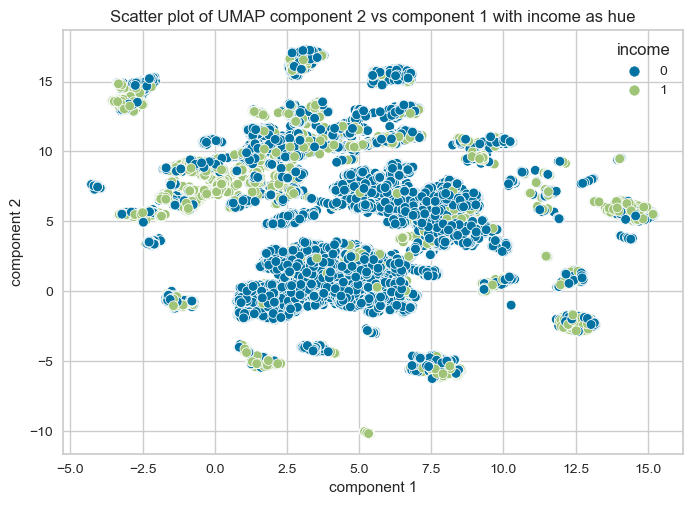

In [473]:
sns.scatterplot(data=df_umap, x='component 1', y='component 2', hue='income')


# set the title and axis labels
plt.title('Scatter plot of UMAP component 2 vs component 1 with income as hue')
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.legend(title='income', loc='upper right')
# display the plot
plt.show()

In [290]:
X_trainUmap

,component 1,component 2
27336,4.840118,0.169951
1402,-2.331155,14.681206
15291,6.795793,2.710796
18606,-1.853618,5.368445
5332,8.146773,4.207387
...,...,...
18693,5.967307,6.433015
25887,10.255234,10.645969
4346,8.244772,7.647045
19149,5.065077,1.949883


In [291]:
mlp.fit(X_trainUmap, y_trainUmap)
mlp_predUmap = mlp.predict(X_testUmap)

In [292]:
cm_mlpUmap = confusion_matrix(y_testUmap, mlp_predUmap)
print("Confusion matrix:\n{}\n".format(cm_mlpUmap))

print(classification_report(y_testUmap, mlp_predUmap,
                            target_names=["<=50k", ">50k"]))

Confusion matrix:
[[4140  391]
 [ 867  635]]

              precision    recall  f1-score   support

       <=50k       0.83      0.91      0.87      4531
        >50k       0.62      0.42      0.50      1502

    accuracy                           0.79      6033
   macro avg       0.72      0.67      0.69      6033
weighted avg       0.78      0.79      0.78      6033



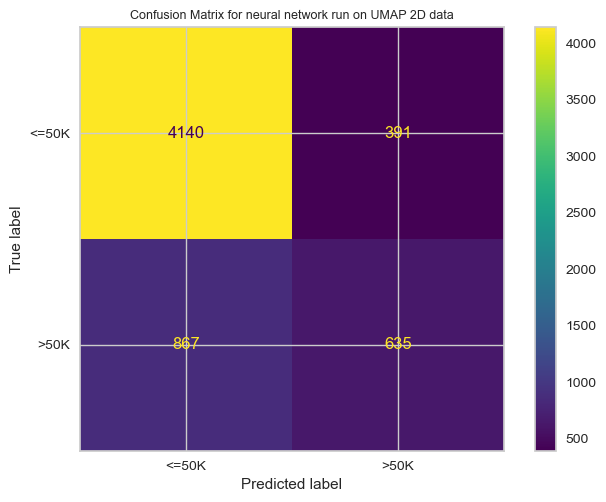

In [294]:
disp = ConfusionMatrixDisplay(confusion_matrix=cm_mlpUmap,display_labels=["<=50K", ">50K"])

disp.plot()
plt.title('Confusion Matrix for neural network run on UMAP 2D data', fontsize=9)
# plt.savefig('decision tree confusion matrix.png', bbox_inches='tight')
plt.show()

###### UmapXGMM Cluster labels as only features

In [296]:
clusFeat = df_umap.drop(['component 1', 'component 2'], axis = 1)
clusFeat.head()

,cluster,income
0,2,0
1,0,0
2,2,0
3,0,0
4,1,0


In [300]:
df_onehot = pd.concat([pd.get_dummies(clusFeat['cluster']), clusFeat.drop('cluster', axis=1)], axis=1)

# print the resulting DataFrame
df_onehot.head()

,0,1,2,3,4,5,6,income
0,0,0,1,0,0,0,0,0
1,1,0,0,0,0,0,0,0
2,0,0,1,0,0,0,0,0
3,1,0,0,0,0,0,0,0
4,0,1,0,0,0,0,0,0


In [301]:
X_o = df_onehot.drop('income', axis =1)
y_o = df_onehot.income

X_trainO, X_testO, y_trainO, y_testO = train_test_split(X_o, y_o, test_size=0.2, random_state=26, stratify=y_o)

In [303]:
mlpO = MLPClassifier(**best_params)

# train the classifier on the entire dataset
mlpO.fit(X_trainO, y_trainO)

# use the classifier to make predictions on new data
mlp_predO = mlpO.predict(X_testO)

In [304]:
cm_mlpO = confusion_matrix(y_testO, mlp_predO)
print("Confusion matrix:\n{}\n".format(cm_mlpO))

print(classification_report(y_testO, mlp_predO,
                            target_names=["<=50k", ">50k"]))

Confusion matrix:
[[4326  205]
 [1301  201]]

              precision    recall  f1-score   support

       <=50k       0.77      0.95      0.85      4531
        >50k       0.50      0.13      0.21      1502

    accuracy                           0.75      6033
   macro avg       0.63      0.54      0.53      6033
weighted avg       0.70      0.75      0.69      6033



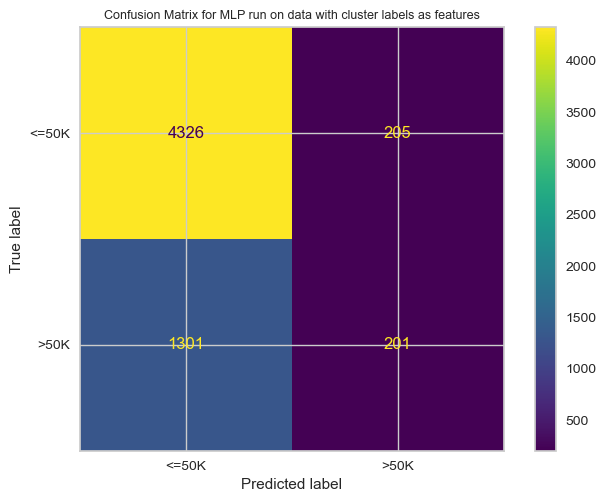

In [306]:
disp = ConfusionMatrixDisplay(confusion_matrix=cm_mlpO,display_labels=["<=50K", ">50K"])

disp.plot()
plt.title('Confusion Matrix for MLP run on data with cluster labels as features', fontsize=9)
# plt.savefig('decision tree confusion matrix.png', bbox_inches='tight')
plt.show()

# Banking

In [476]:
df = pd.read_csv('bank.csv')

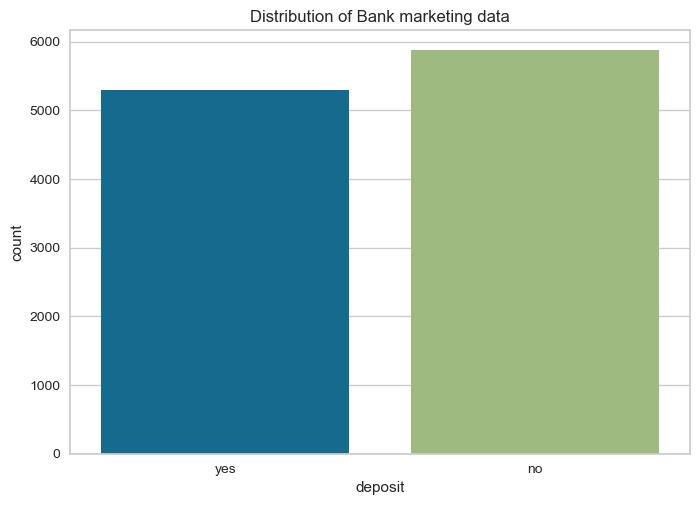

In [475]:
sns.countplot(x = df['deposit'])
plt.title("Distribution of Bank marketing data")
plt.show()

In [331]:
df['deposit'] = df['deposit'].replace({'yes':1, 'no': 0})
df['housing'] = df['housing'].replace({'yes':1, 'no': 0})
df['loan'] = df['loan'].replace({'yes':1, 'no': 0})
df['default'] = df['default'].replace({'yes':1, 'no': 0})


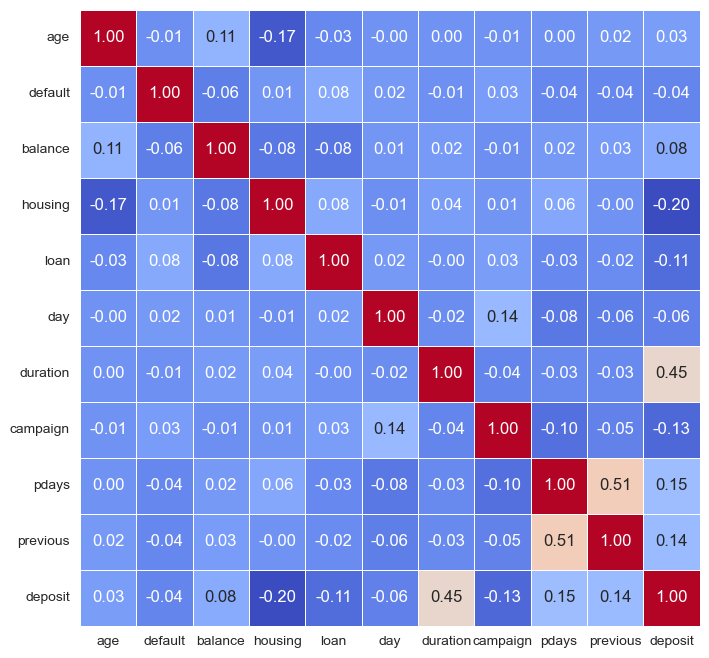

In [332]:
corr = df.corr()

# plot the correlation matrix using heatmap
# sns.heatmap(corr, annot=True, cmap='coolwarm')

ax = sns.heatmap(corr, cmap='coolwarm', annot=True, fmt='.2f', cbar=False, linewidths=.5)

# Set the size of the plot to 10x10 inches
ax.figure.set_size_inches(8, 8)

# show the plot
plt.show()

In [333]:
df = df.drop('poutcome', axis =1)

In [334]:
df = df[(df != 'unknown').all(axis=1)]

In [344]:
df['education'] = df['education'].replace({'tertiary':2, 'secondary': 1, 'primary':0})

In [335]:
catV = [col for col in df.columns if df[col].dtype == "object"]

In [345]:
from sklearn.compose import make_column_transformer
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, StandardScaler, MinMaxScaler
ct = make_column_transformer(
    (StandardScaler(),['age', 'balance','campaign', 'pdays', 'previous']),
    (OneHotEncoder(sparse=False), ['job','marital','contact','month']),
    (MinMaxScaler(), ['education']))

In [417]:
df.reset_index(drop=True, inplace=True)
df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,deposit
0,28,blue-collar,single,1,0,-127,1,0,cellular,4,jul,1044,3,-1,0,1
1,55,blue-collar,married,1,0,49,1,0,cellular,7,jul,494,4,-1,0,1
2,51,technician,married,1,0,216,0,0,cellular,7,jul,615,2,-1,0,1
3,39,technician,single,1,0,506,1,0,cellular,7,jul,718,2,-1,0,1
4,42,blue-collar,divorced,0,0,213,1,0,cellular,7,jul,434,3,-1,0,1


In [418]:
df.deposit.value_counts(normalize=True)

1    0.53771
0    0.46229
Name: deposit, dtype: float64

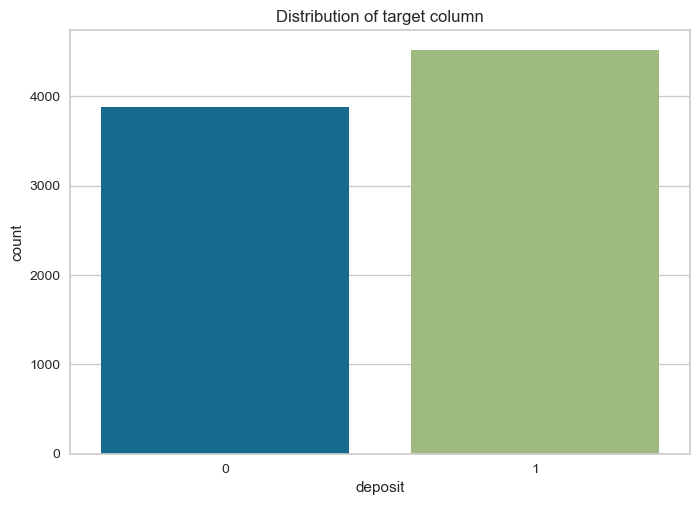

In [419]:
sns.countplot(x = df['deposit'])
plt.title("Distribution of target column")
plt.show()

In [420]:
bankX = df.drop('deposit', axis = 1)
bankX.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous
0,28,blue-collar,single,1,0,-127,1,0,cellular,4,jul,1044,3,-1,0
1,55,blue-collar,married,1,0,49,1,0,cellular,7,jul,494,4,-1,0
2,51,technician,married,1,0,216,0,0,cellular,7,jul,615,2,-1,0
3,39,technician,single,1,0,506,1,0,cellular,7,jul,718,2,-1,0
4,42,blue-collar,divorced,0,0,213,1,0,cellular,7,jul,434,3,-1,0


In [421]:
ct.fit(bankX)
bankX_trans = ct.transform(bankX)
print(bankX_trans.shape)

(8393, 34)


###### KMeans on banking data

In [422]:
kmeans = KMeans(n_clusters=2, random_state = 26)
kmeans.fit(bankX_trans)

# Evaluate the clustering results
print(kmeans.inertia_)

54059.968515759654


In [423]:
analysisData = bankX.copy()

In [424]:
analysisData['cluster'] = kmeans.labels_

In [425]:
df.deposit.value_counts(normalize = True)

1    0.53771
0    0.46229
Name: deposit, dtype: float64

In [426]:
analysisData['cluster'].value_counts(normalize = True)

0    0.735256
1    0.264744
Name: cluster, dtype: float64

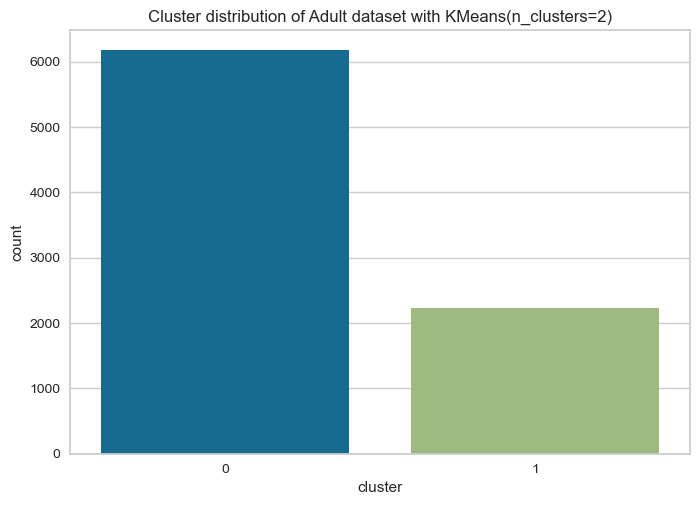

In [427]:
sns.countplot(x = analysisData['cluster'])
plt.title("Cluster distribution of Adult dataset with KMeans(n_clusters=2)")
plt.show()

In [428]:
analysisData.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,cluster
0,28,blue-collar,single,1,0,-127,1,0,cellular,4,jul,1044,3,-1,0,0
1,55,blue-collar,married,1,0,49,1,0,cellular,7,jul,494,4,-1,0,0
2,51,technician,married,1,0,216,0,0,cellular,7,jul,615,2,-1,0,0
3,39,technician,single,1,0,506,1,0,cellular,7,jul,718,2,-1,0,0
4,42,blue-collar,divorced,0,0,213,1,0,cellular,7,jul,434,3,-1,0,0


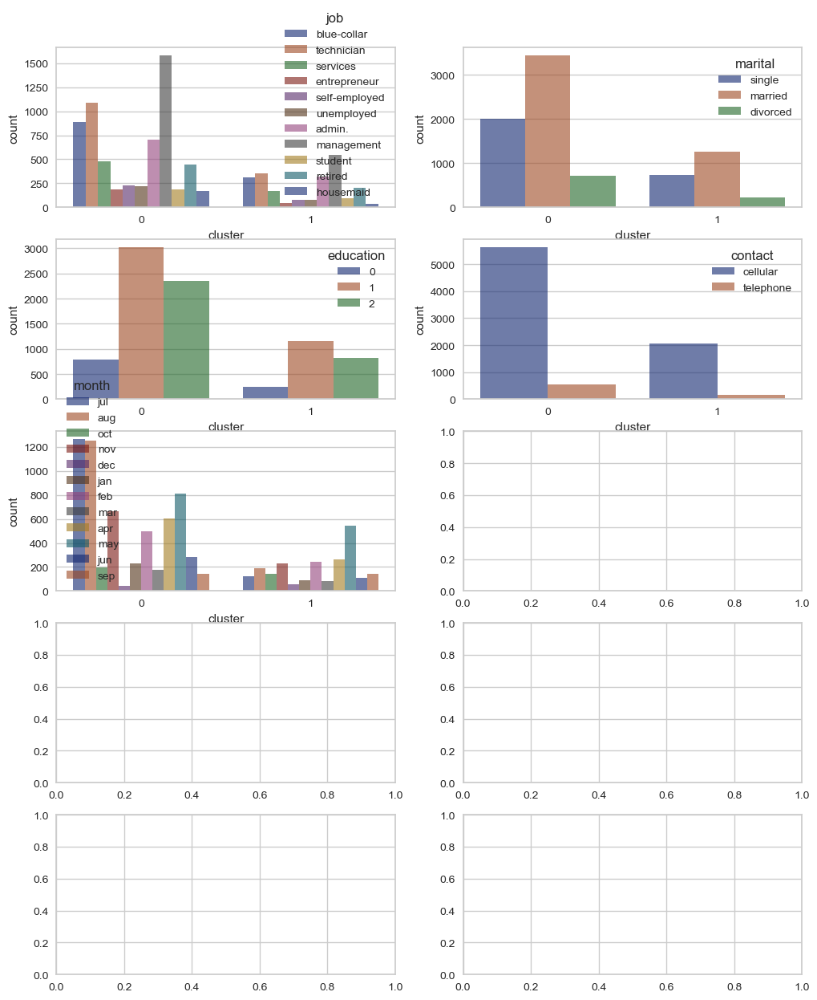

In [429]:
fig, axes = plt.subplots(5,2,figsize=(12,15))
for idx,cat_col in enumerate(catV):
    row,col = idx//2,idx%2
    sns.countplot(data=analysisData, x = 'cluster', hue=cat_col, palette = 'dark', alpha=.6, ax = axes[row,col]) 

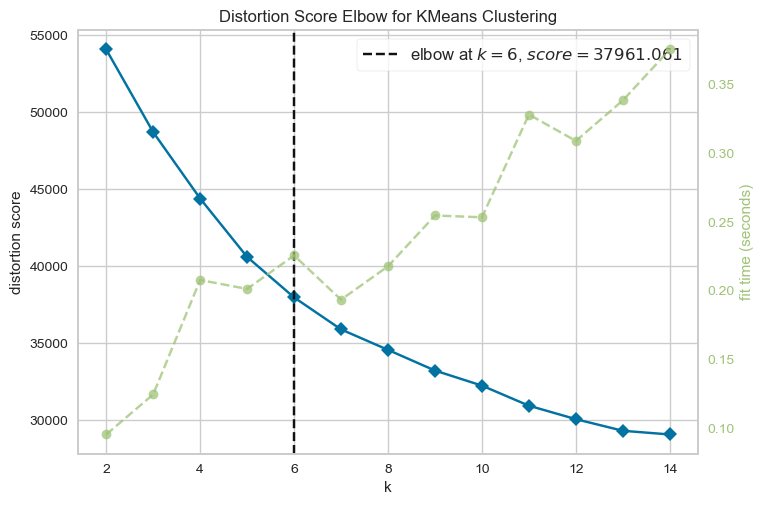

In [430]:
elbowPlotKMeans(bankX_trans)

In [431]:
kmeans6 = KMeans(n_clusters=6, random_state = 26)
kmeans6.fit(bankX_trans)

KMeans(n_clusters=6, random_state=26)

In [432]:
anal6 = bankX.copy()

In [433]:
anal6['cluster'] = kmeans6.labels_

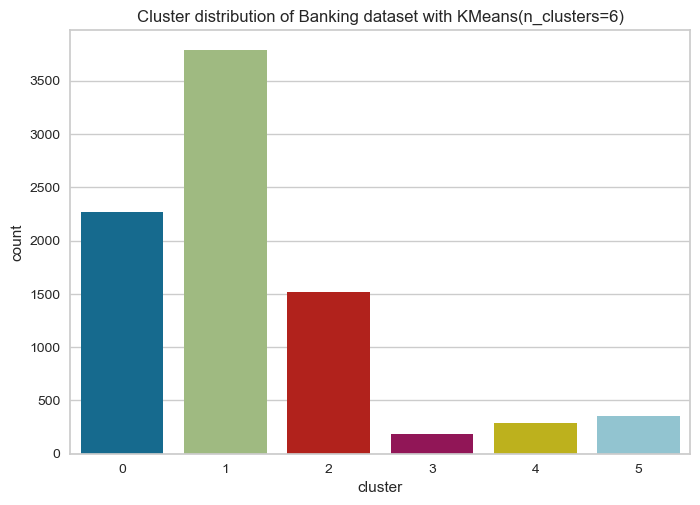

In [434]:
sns.countplot(x = anal6['cluster'])
plt.title("Cluster distribution of Banking dataset with KMeans(n_clusters=6)")
plt.show()

In [435]:
for idx,cat_col in enumerate(catV):
    row,col = idx//2,idx%2
    sns.countplot(data=anal6, x = 'cluster', hue=cat_col, palette = 'dark', alpha=.6, ax = axes[row,col]) 

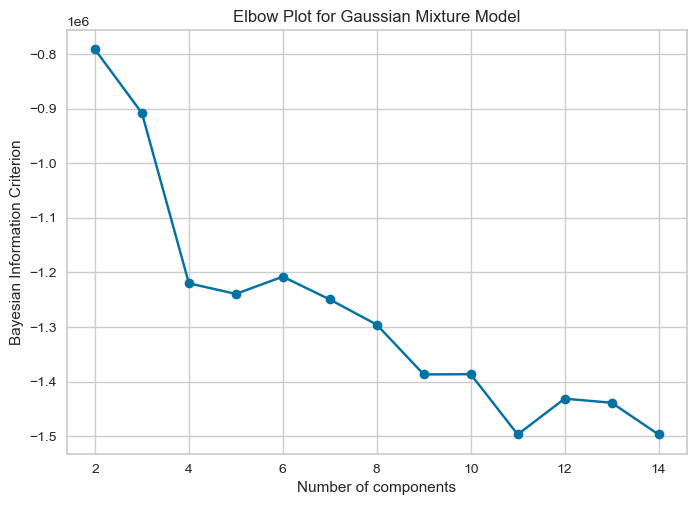

In [370]:
elbowPlotGMM(bankX_trans)

In [436]:
gmm = GaussianMixture(n_components=2, random_state=42)

gmm.fit(bankX_trans)

labels = gmm.predict(bankX_trans)

In [437]:
gmmAnal2 = bankX.copy()

gmmAnal2['cluster'] = labels

In [438]:
gmmAnal2['cluster'].value_counts(normalize=True)

0    0.650066
1    0.349934
Name: cluster, dtype: float64

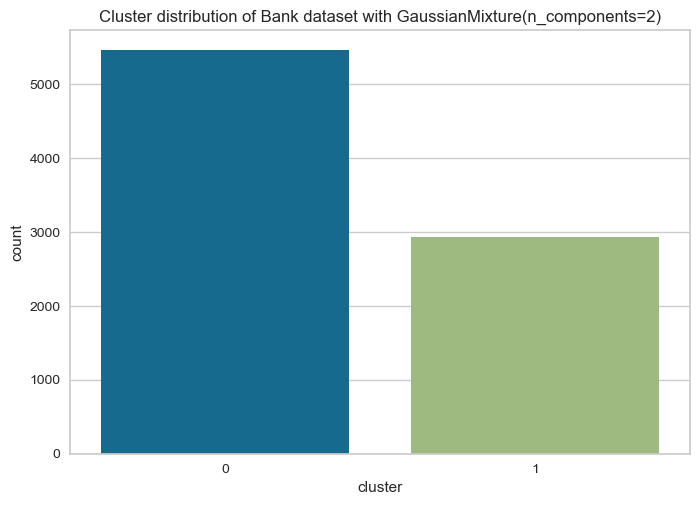

In [374]:
sns.countplot(x = gmmAnal2['cluster'])
plt.title("Cluster distribution of Bank dataset with GaussianMixture(n_components=2)")
plt.show()

###### PCA

In [439]:
pca = PCA()
scaler = StandardScaler()
X_std = scaler.fit_transform(bankX_trans)
pca.fit(X_std)
pca.explained_variance_ratio_

array([8.14110849e-02, 5.84085379e-02, 5.48807372e-02, 5.23949883e-02,
       4.43511373e-02, 3.95915617e-02, 3.79190483e-02, 3.50783750e-02,
       3.50243768e-02, 3.34355633e-02, 3.25763866e-02, 3.23852166e-02,
       3.17435538e-02, 3.14741456e-02, 3.11099123e-02, 3.08619386e-02,
       3.06951820e-02, 3.01115881e-02, 2.99678249e-02, 2.96970469e-02,
       2.90832201e-02, 2.84087691e-02, 2.76738327e-02, 2.66567160e-02,
       2.49589161e-02, 2.37616386e-02, 2.14698524e-02, 1.44220334e-02,
       1.12931511e-02, 9.15366475e-03, 7.39353334e-31, 1.60555055e-32,
       1.52853317e-33, 4.02827971e-34])

In [441]:
pca.explained_variance_ratio_[-5:].sum()

0.009153664752478977

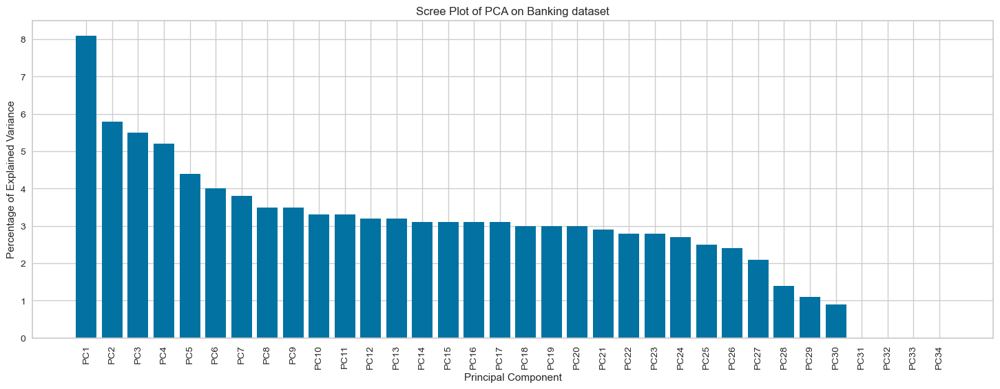

In [442]:
per_var = np.round(pca.explained_variance_ratio_* 100, decimals=1)
xlabels = ['PC' + str(x) for x in range(1, len(per_var)+1)]

fig = plt.figure(figsize=(18, 6))
plt.bar(x=range(1,len(per_var)+1), height=per_var, tick_label=xlabels)
plt.ylabel('Percentage of Explained Variance')
plt.xlabel('Principal Component')
plt.xticks(rotation=90)
plt.title('Scree Plot of PCA on Banking dataset')
plt.show()

###### ICA

In [446]:
from sklearn.decomposition import FastICA

# Assume that X is your feature matrix

# Apply ICA to the features
ica = FastICA(random_state = 26)  # Choose the number of components you want to keep
X_ica = ica.fit_transform(X_std)

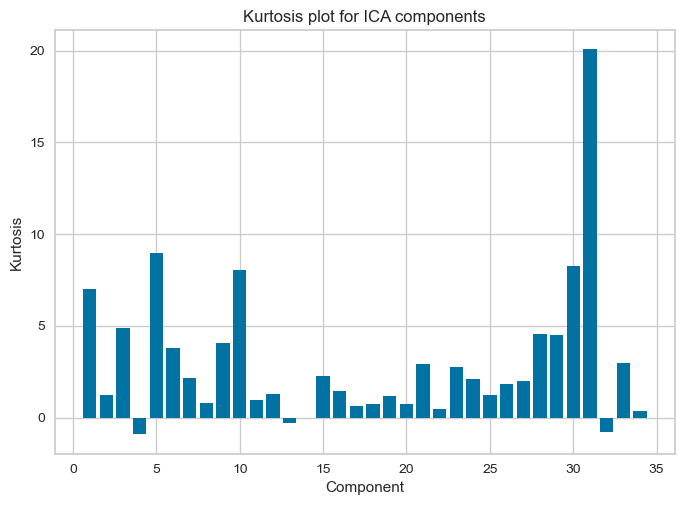

In [447]:
kurt = kurtosis(X_ica)
fig, ax = plt.subplots()
ax.bar(np.arange(1, len(kurt)+1), kurt)
ax.set_xlabel('Component')
ax.set_ylabel('Kurtosis')
ax.set_title('Kurtosis plot for ICA components')
plt.show()

In [448]:
X_umap = UmapDimentionReduction(X_std)

In [449]:
bankTransDf = pd.DataFrame(bankX_trans, columns=ct.get_feature_names_out())

In [450]:
bankTransDf['deposit'] = df['deposit']

In [452]:
df.deposit.value_counts()

1    4513
0    3880
Name: deposit, dtype: int64

In [451]:
bankTransDf.deposit.value_counts()

1    4513
0    3880
Name: deposit, dtype: int64

In [454]:
features = bankTransDf.loc[:, :'minmaxscaler__education']
features

,standardscaler__age,standardscaler__balance,standardscaler__campaign,standardscaler__pdays,standardscaler__previous,onehotencoder__job_admin.,onehotencoder__job_blue-collar,onehotencoder__job_entrepreneur,onehotencoder__job_housemaid,onehotencoder__job_management,...,onehotencoder__month_feb,onehotencoder__month_jan,onehotencoder__month_jul,onehotencoder__month_jun,onehotencoder__month_mar,onehotencoder__month_may,onehotencoder__month_nov,onehotencoder__month_oct,onehotencoder__month_sep,minmaxscaler__education
0,-1.079817,-0.510814,0.229059,-0.558943,-0.416661,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5
1,1.118612,-0.458761,0.635677,-0.558943,-0.416661,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5
2,0.792919,-0.409369,-0.177559,-0.558943,-0.416661,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5
3,-0.184160,-0.323598,-0.177559,-0.558943,-0.416661,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5
4,0.060109,-0.410256,0.229059,-0.558943,-0.416661,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8388,-0.591277,-0.494547,1.042295,-0.558943,-0.416661,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5
8389,-0.672700,-0.472957,-0.584177,-0.558943,-0.416661,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8390,-0.754123,-0.464676,-0.177559,-0.558943,-0.416661,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5
8391,0.141533,-0.473253,-0.177559,0.922138,1.564664,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.5


In [457]:
features = bankTransDf.loc[:, :'minmaxscaler__education']

# gmmXumap = GaussianMixture(n_components=7, random_state=42)

umap_2d = umap.UMAP(n_components=2, init='random', random_state=0)
umap_3d = umap.UMAP(n_components=3, init='random', random_state=0)

proj_2d = umap_2d.fit_transform(features)
proj_3d = umap_3d.fit_transform(features)

fig_2d = px.scatter(
    proj_2d, x=0, y=1,
    color=bankTransDf.deposit, labels={'color': 'deposit'}
)
fig_2d.update_layout(
    title={
        'text': "2D representation of original data with deposit as the hue",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        
    }, xaxis_title="dimension 1",
    yaxis_title="dimension 2")

fig_2d.show()

In [462]:
df_umap = pd.DataFrame(proj_2d, columns=['component {}'.format(i) for i in [1,2]])
df_umap['deposit'] = df['deposit']
df_umap.head()

,component 1,component 2,deposit
0,12.663324,2.947056,1
1,10.163797,-0.062446,1
2,11.294670,4.561316,1
3,1.764935,0.185858,1
4,8.874117,-0.213310,1


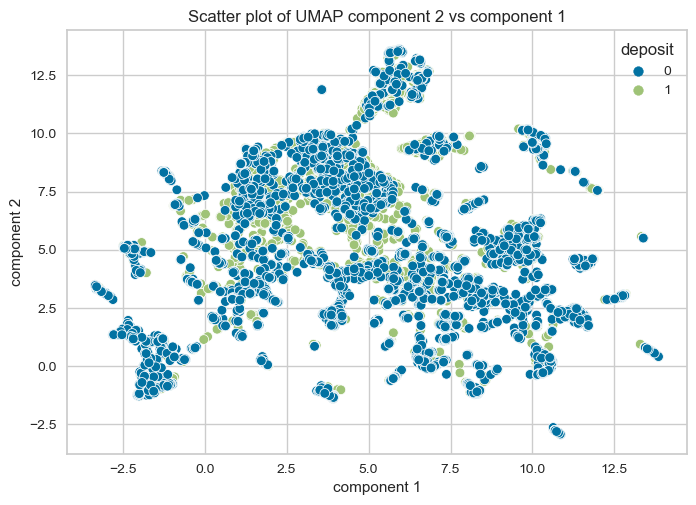

In [463]:
sns.scatterplot(data=df_umap, x='component 1', y='component 2', hue='deposit')


# set the title and axis labels
plt.title('Scatter plot of UMAP component 2 vs component 1')
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.legend(title='deposit', loc='upper right')
# display the plot
plt.show()